## Refine Myeloid cell annotations for large intestine - relabelling uncertain cells based on majority voting

In [1]:
import scanpy as sc
import pandas as pd
import numpy as np
import sys
import os
from collections import Counter

import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import to_hex
import ast

In [2]:
sc.logging.print_header()

scanpy==1.8.0 anndata==0.8.0 umap==0.4.6 numpy==1.20.1 scipy==1.6.1 pandas==1.3.5 scikit-learn==0.24.1 statsmodels==0.13.5 python-igraph==0.8.3 louvain==0.7.0 leidenalg==0.8.3 pynndescent==0.5.2


In [3]:
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42

In [4]:
sc.set_figure_params(
    dpi=200,dpi_save=300,
    fontsize=12,
    frameon=False,
    transparent=True,
)

In [5]:
sns.set_style(style="white")
sns.set_context(context="paper")

In [6]:
adata = sc.read_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/neutrophils/pooled_healthy.gene_cellbender.bad_qc_cluster_mito80.neutrophil.20221013.h5ad')

In [7]:
adata

AnnData object with n_obs × n_vars = 1893 × 36601
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_spli

In [8]:
adata_scanvi = pd.read_csv('/nfs/team205/ao15/Megagut/Annotations_v3/neutrophils/neutrophils_fine_annot_predict_Myeloid_20231205.csv.gz',compression='gzip',index_col=0)

In [9]:
adata_scanvi

,LV1,LV2,LV3,LV4,LV5,LV6,LV7,LV8,LV9,LV10,LV11,LV12,LV13,LV14,LV15,LV16,LV17,LV18,LV19,LV20
index,,,,,,,,,,,,,,,,,,,,
AAACCTGCAACTGCGC-HCA_A_GT12934997,0.033563,-0.391292,0.040294,-0.018477,-0.001172,0.033570,-0.014224,0.106980,0.534874,-0.041126,-0.041765,1.111293,-0.043894,0.033865,0.119253,1.513346,-0.832048,-0.379948,-0.076956,0.381420
AAACCTGCATGGTAGG-HCA_A_GT12934997,-0.077797,0.452313,-0.065910,-0.034797,-2.211979,-0.022374,-0.022582,-1.438516,0.431585,0.106129,0.015042,0.851995,-0.030043,0.019532,0.111502,1.406260,-0.523317,0.151111,-0.100615,0.619336
AAAGATGAGGACAGCT-HCA_A_GT12934997,-0.012602,0.037263,-0.020615,-0.041065,-1.268910,0.544469,-0.023707,-0.613164,0.195794,0.062300,-0.027540,0.964204,-0.026486,0.076705,0.066923,0.727341,-0.118953,0.555483,-0.144940,-0.007717
AAAGTAGTCAACGAAA-HCA_A_GT12934997,-0.024603,0.271095,-0.001835,-0.040420,-1.228815,-0.003108,-0.033042,-0.946044,0.488210,0.057857,-0.005621,0.874919,-0.024205,0.039137,0.110575,0.789700,-0.570791,0.477219,-0.019614,0.304519
AACACGTAGAGACTAT-HCA_A_GT12934997,0.023107,-0.167928,0.007210,-0.016405,-0.438924,-0.079907,-0.015108,-0.748051,0.981965,-0.019653,-0.022746,1.071893,-0.060879,0.078643,0.152604,1.677763,-1.155638,0.229965,-0.271024,-0.000513
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
CTACATTGTCTGCCAG-HT228-fetal-ileum,0.053900,0.554391,0.119569,-0.064116,0.639771,-0.619614,0.010737,1.845639,0.742203,-0.104842,-0.073525,1.561031,0.001193,0.034002,0.199662,3.107436,-1.338304,-2.177782,-0.285894,-0.155706
CTCGTCATCACCTTAT-HT228-fetal-ileum,0.019421,1.222097,0.139391,-0.084192,1.170143,-0.345816,0.015772,1.804881,0.393355,-0.161620,-0.069417,1.919097,-0.054114,0.031082,0.195036,3.177615,-1.812262,-2.686930,-0.495503,0.190856
TGACAACAGAAGGGTA-HT228-fetal-ileum,-0.019873,-0.104128,-0.035479,0.006065,-1.134384,0.001954,0.012977,-1.320422,1.111769,-0.033119,-0.053933,1.699494,-0.078153,0.042400,0.161274,2.539389,-1.436924,-0.591182,-0.315375,0.337204


In [10]:
adata.obsm['X_scANVI'] = adata_scanvi

In [11]:
adata_meta = pd.read_csv('/nfs/team205/ao15/Megagut/Annotations_v3/neutrophils/neutrophils_fine_annot_predict_Myeloid_20231205_meta.csv',index_col=0)

In [12]:
adata_meta

,latent_cell_probability,latent_RT_efficiency,cecilia22_predH,cecilia22_predH_prob,cecilia22_predH_uncertain,cecilia22_predL,cecilia22_predL_prob,cecilia22_predL_uncertain,elmentaite21_pred,elmentaite21_pred_prob,...,cell_fraction_unified,cell_sorting,technology,include_150722,_scvi_batch,fine_annot,_scvi_labels,fine_predicted_labels,fine_predicted_labels_uncertainty,scanvi_pred
index,,,,,,,,,,,,,,,,,,,,,
AAACCTGCAACTGCGC-HCA_A_GT12934997,0.999836,0.857807,Monocytes,0.990857,Monocytes,Classical monocytes,0.922057,Classical monocytes,Monocytes,0.780143,...,Total,None,10X_5p,healthy_reference,97,Unknown,17,Monocyte,0.099994,Monocyte
AAACCTGCATGGTAGG-HCA_A_GT12934997,0.999973,1.019605,Monocytes,0.995862,Monocytes,Classical monocytes,0.995586,Classical monocytes,Monocytes,0.414794,...,Total,None,10X_5p,healthy_reference,97,Unknown,17,Monocyte,0.039990,Monocyte
AAAGATGAGGACAGCT-HCA_A_GT12934997,0.999740,0.827556,Monocytes,0.987690,Monocytes,Classical monocytes,0.968681,Classical monocytes,Monocytes,0.879200,...,Total,None,10X_5p,healthy_reference,97,Unknown,17,Monocyte,0.080006,Monocyte
AAAGTAGTCAACGAAA-HCA_A_GT12934997,0.999746,0.844798,Monocytes,0.904525,Monocytes,Classical monocytes,0.408359,Classical monocytes,Monocytes,0.982469,...,Total,None,10X_5p,healthy_reference,97,Unknown,17,Monocyte,0.059993,Monocyte
AACACGTAGAGACTAT-HCA_A_GT12934997,0.999990,1.046917,Monocytes,0.999294,Monocytes,Classical monocytes,0.961076,Classical monocytes,Monocytes,0.095466,...,Total,None,10X_5p,healthy_reference,97,Unknown,17,Monocyte,0.020000,Monocyte
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
CTACATTGTCTGCCAG-HT228-fetal-ileum,0.999368,0.764953,Monocytes,0.290352,Uncertain,Classical monocytes,0.554634,Classical monocytes,Monocytes,0.963459,...,Total,None,10X_3pv2,healthy_reference,159,Unknown,17,Mono/neutrophil_MPO,0.299610,Mono/neutrophil_MPO
CTCGTCATCACCTTAT-HT228-fetal-ileum,0.999655,0.781690,Monocytes,0.732175,Monocytes,Classical monocytes,0.912063,Classical monocytes,Monocytes,0.941024,...,Total,None,10X_3pv2,healthy_reference,159,Unknown,17,Mono/neutrophil_MPO,0.339713,Mono/neutrophil_MPO
TGACAACAGAAGGGTA-HT228-fetal-ileum,0.999645,0.805281,Monocytes,0.999954,Monocytes,Classical monocytes,0.999600,Classical monocytes,Monocytes,1.000000,...,Total,None,10X_3pv2,healthy_reference,159,Unknown,17,Monocyte,0.000000,Monocyte


In [13]:
adata.obs = adata_meta

In [14]:
sc.pp.neighbors(adata, use_rep="X_scANVI")
sc.tl.umap(adata)

In [15]:
adata

AnnData object with n_obs × n_vars = 1893 × 36601
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_spli

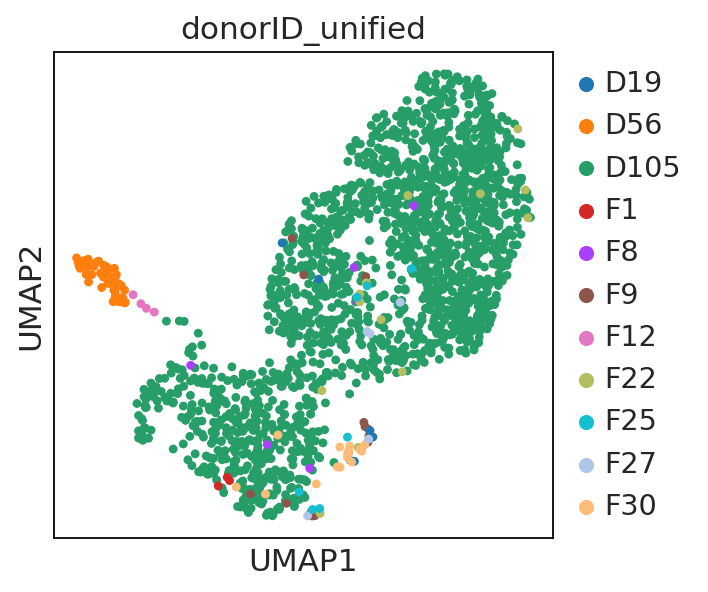

In [19]:
plt.rcParams['figure.figsize'] = [5,5]
sc.set_figure_params(dpi_save = 300)
sc.pl.umap(adata,color='donorID_unified',save='neutrophils_donor.pdf')

/home/jovyan/my-conda-envs/standard_plotting/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


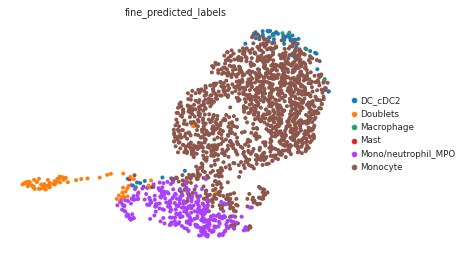

In [15]:
sc.pl.umap(adata, color=['fine_predicted_labels'])

In [16]:
adata.obs.donor_disease.unique()

['organ_donor', 'cancer', 'Fistula_revision']
Categories (3, object): ['Fistula_revision', 'cancer', 'organ_donor']

In [17]:
adata.obs['disease'] = adata.obs['donor_category'].astype(str) + '_' + adata.obs['donor_disease'].astype(str)

In [18]:
list(adata.obs.disease.unique())

['control_organ_donor',
 'inutero_organ_donor',
 'control_cancer',
 'preterm_Fistula_revision']

In [19]:
adata.obs.disease.value_counts()

control_organ_donor         1818
inutero_organ_donor           53
preterm_Fistula_revision      15
control_cancer                 7
Name: disease, dtype: int64

In [20]:
adata.obs.donor_disease.unique()

['organ_donor', 'cancer', 'Fistula_revision']
Categories (3, object): ['Fistula_revision', 'cancer', 'organ_donor']

In [23]:
adata.obs['disease'] = (adata.obs['donor_disease'].map(lambda x:{
'organ_donor':'control', 'cancer':'control', 'Fistula_revision':'control'
    }.get(x,x)).astype("category"))

In [24]:
list(adata.obs.disease.unique())

['control']

In [25]:
adata.X.max()

1277.0

In [26]:
adata.layers['counts'] = adata.X

In [27]:
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

In [28]:
marker_genes_dict = {
                    'Mono/neutrophil_MPO':['MPO','RETN','RNASE2','PCLAF'],
                    'Monocyte':['CD14','EREG','NAMPT','PLAUR','VCAN','FPR1'],
'Neutrophil':["CEACAM8", "PROK2", "CXCR2", "S100A12",'SPI1','KIT','GFI1','FUT4','FCGR3A','SELL']
}

In [29]:
adata

AnnData object with n_obs × n_vars = 1893 × 36601
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_spli

/home/jovyan/my-conda-envs/standard_plotting/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


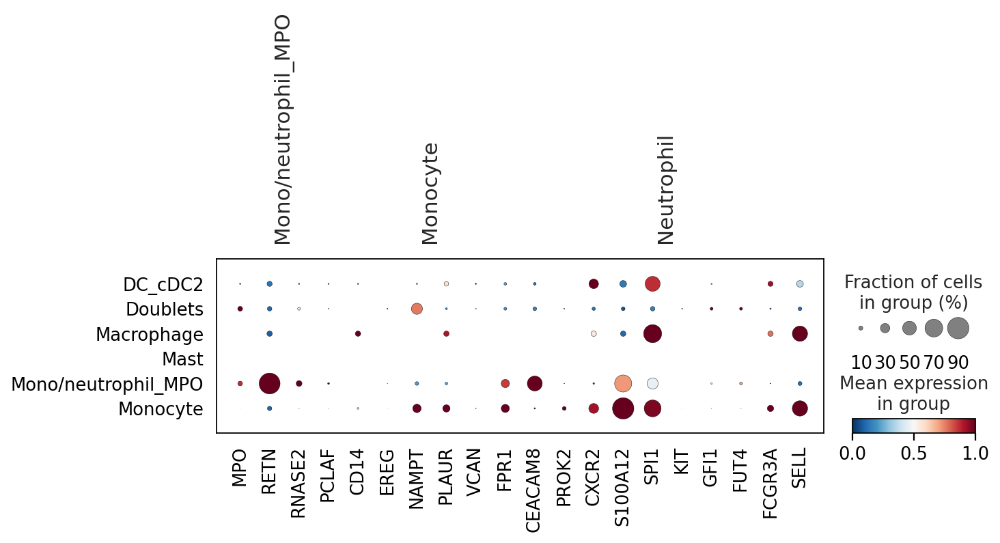

In [30]:
sc.set_figure_params(dpi_save = 300)
sc.pl.dotplot(adata,var_names=marker_genes_dict,groupby='fine_predicted_labels',color_map='RdBu_r', standard_scale='var')

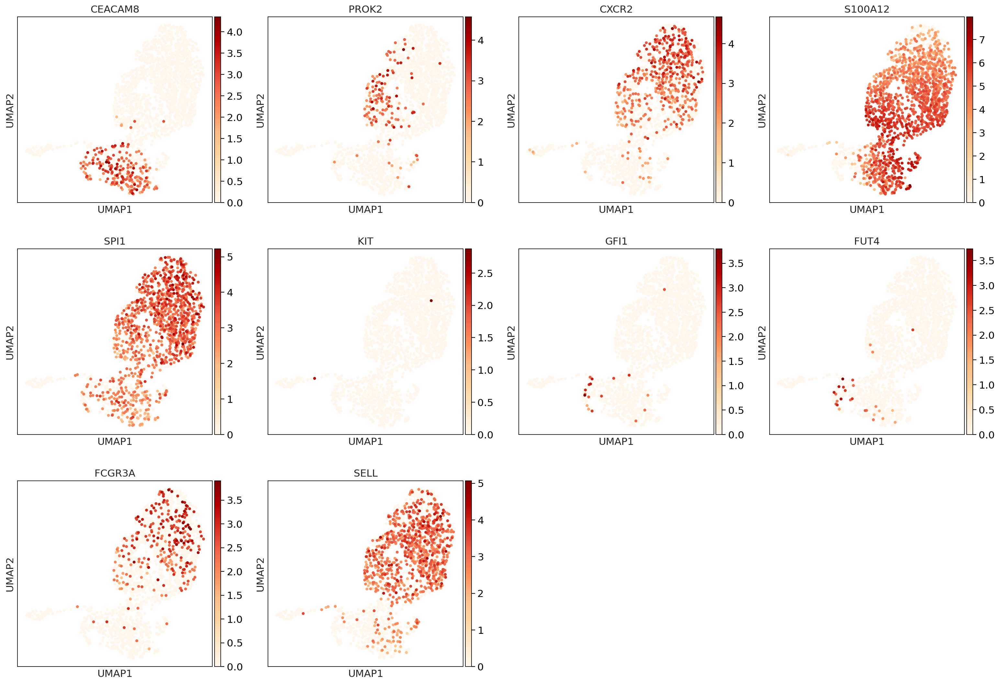

In [45]:
sc.pl.umap(adata,color=["CEACAM8", "PROK2", "CXCR2", "S100A12",'SPI1','KIT','GFI1','FUT4','FCGR3A','SELL'],cmap='OrRd',save='neutrophil_markers_scanvimapping.pdf')

In [32]:
uncert = adata.obs[['fine_predicted_labels','fine_predicted_labels_uncertainty']] 

In [33]:
#calculate 90th percentile to use as cut off for uncertain cells
p = np.percentile(adata.obs['fine_predicted_labels_uncertainty'], 90) # return 90th percentile
print(p)

0.4598557770124722


(array([657., 174., 162., 187.,  48.,  53.,  36.,  66.,  30.,  28.,  25.,
         57.,  30.,  29.,  44.,  29.,  20.,  26.,  49.,  31.,  18.,  13.,
         27.,  12.,  15.,  14.,   8.,   2.,   1.,   2.]),
 array([0.        , 0.02533251, 0.05066503, 0.07599754, 0.10133005,
        0.12666257, 0.15199508, 0.17732759, 0.20266011, 0.22799262,
        0.25332513, 0.27865765, 0.30399016, 0.32932267, 0.35465519,
        0.3799877 , 0.40532021, 0.43065273, 0.45598524, 0.48131775,
        0.50665027, 0.53198278, 0.55731529, 0.58264781, 0.60798032,
        0.63331284, 0.65864535, 0.68397786, 0.70931038, 0.73464289,
        0.7599754 ]),
 <BarContainer object of 30 artists>)

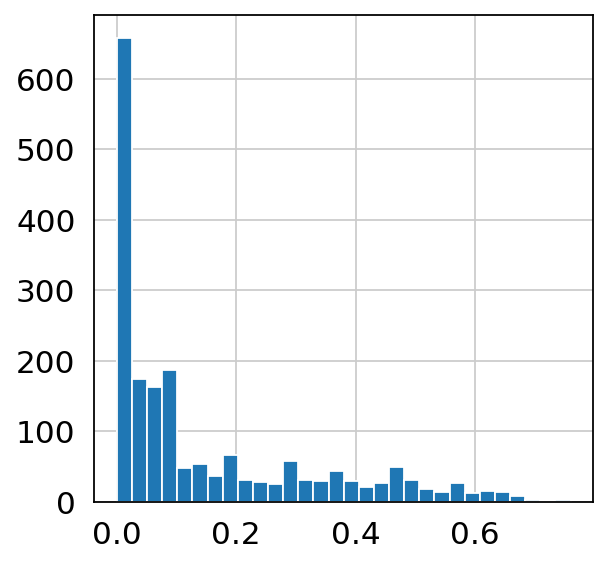

In [34]:
#plot uncertainty distribution
plt.hist(adata.obs['fine_predicted_labels_uncertainty'], bins=30)

In [35]:
uncert['fine_predicted_labels'] = uncert['fine_predicted_labels'].cat.add_categories('Unknown')

<ipython-input-35-905f2ed234d6>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  uncert['fine_predicted_labels'] = uncert['fine_predicted_labels'].cat.add_categories('Unknown')


In [36]:
adata.obs['fine_predicted_labels'].unique()

['Monocyte', 'Mono/neutrophil_MPO', 'Doublets', 'DC_cDC2', 'Macrophage', 'Mast']
Categories (6, object): ['DC_cDC2', 'Doublets', 'Macrophage', 'Mast', 'Mono/neutrophil_MPO', 'Monocyte']

In [37]:
#mark cells are unknown based on cut off of 90th percentile rounded to the nearest second decimal
uncert.loc[uncert["fine_predicted_labels_uncertainty"] > p, "fine_predicted_labels"] = "Unknown"

/home/jovyan/my-conda-envs/standard_plotting/lib/python3.8/site-packages/pandas/core/indexing.py:1817: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_column(loc, value, pi)


In [38]:
adata.obs['fine_predicted_labels_uncertflagged'] = adata.obs['fine_predicted_labels']

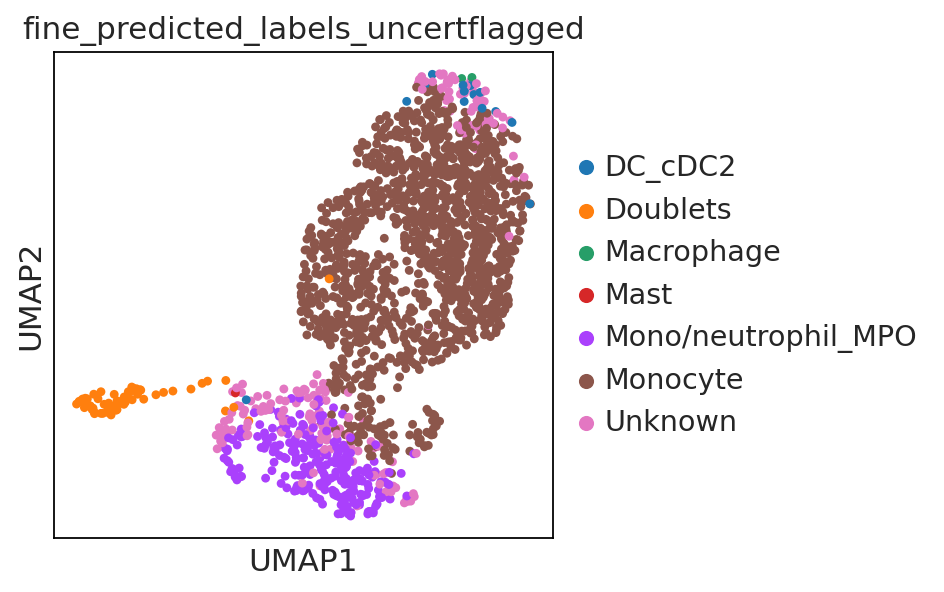

In [39]:
ON = {O:N for O,N in zip(uncert.index,uncert["fine_predicted_labels"])}
adata.obs["fine_predicted_labels_uncertflagged"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["fine_predicted_labels_uncertflagged"])]
sc.pl.umap(adata,color='fine_predicted_labels_uncertflagged')

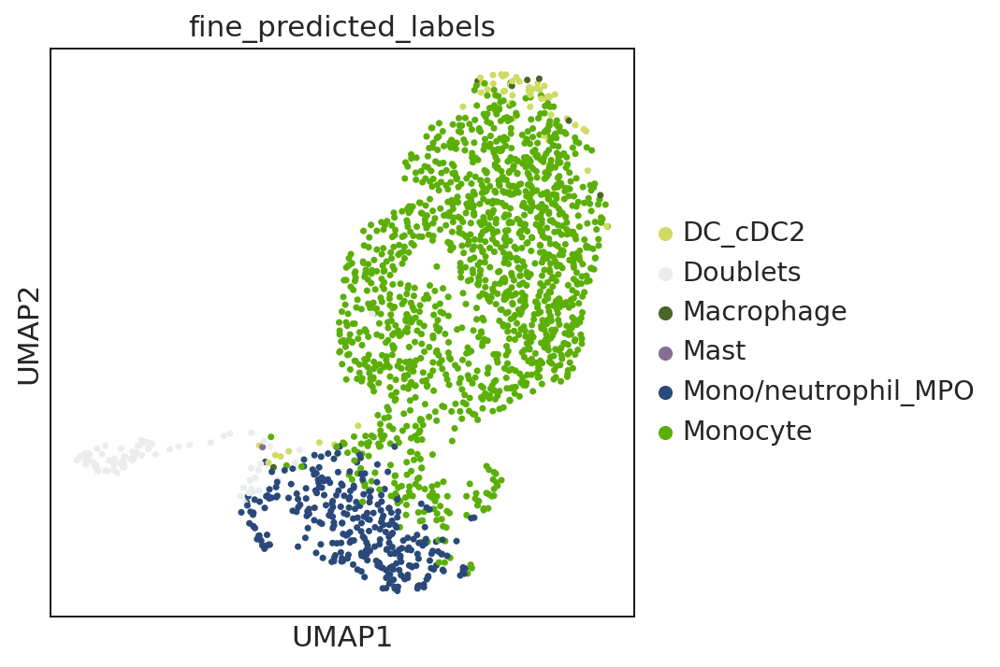

In [47]:
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(adata,color='fine_predicted_labels',palette = [#'#8c543f',#DC_cDC1
'#cfdb65',#DC_cDC2
#'#c7a642',#DC_langerhans
#'#e6a519',#DC_migratory
#'#bdb197',#DC_pDC
 '#ebeded',#doublets
#'#8b4eba',#Eosinophil/basophil
#'#0e539c',#Erythrocytes
'#486626',#Macrophage
#'#caf9cf',#Macrophage_CD5L
#'#8fd9d0',#Macrophage_LYVE1
#'#c1ed15',#Macrophage_MMP9
#'#42c7ac',#Macrophage_TREM2
'#826e91',#Mast
#'#c730aa',#Megakaryocyte/platelet
'#2a497a',#Mono/neutrophil_MPO
'#5baf07',#Monocyte 
#'#000000'#unknown
                                                                       ],size=40,save='neutrophils_scanvi_knnpred.pdf')

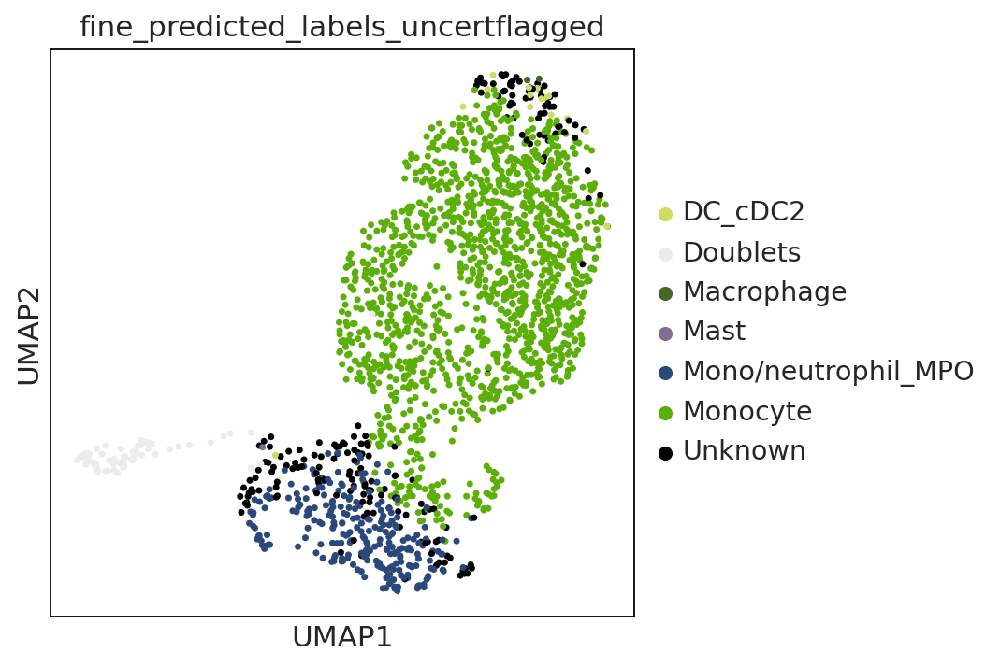

In [48]:
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(adata,color='fine_predicted_labels_uncertflagged',palette = [#'#8c543f',#DC_cDC1
'#cfdb65',#DC_cDC2
#'#c7a642',#DC_langerhans
#'#e6a519',#DC_migratory
#'#bdb197',#DC_pDC
 '#ebeded',#doublets
#'#8b4eba',#Eosinophil/basophil
#'#0e539c',#Erythrocytes
'#486626',#Macrophage
#'#caf9cf',#Macrophage_CD5L
#'#8fd9d0',#Macrophage_LYVE1
#'#c1ed15',#Macrophage_MMP9
#'#42c7ac',#Macrophage_TREM2
'#826e91',#Mast
#'#c730aa',#Megakaryocyte/platelet
'#2a497a',#Mono/neutrophil_MPO
'#5baf07',#Monocyte 
'#000000'#unknown
                                                                       ],size=40,save='neutrophils_scanvi_knnpred_uncertflagged.pdf')

In [49]:
#reassign labels for unknown cells by leiden clustering and majority voting
sc.tl.leiden(adata,resolution=1,key_added='leiden1')

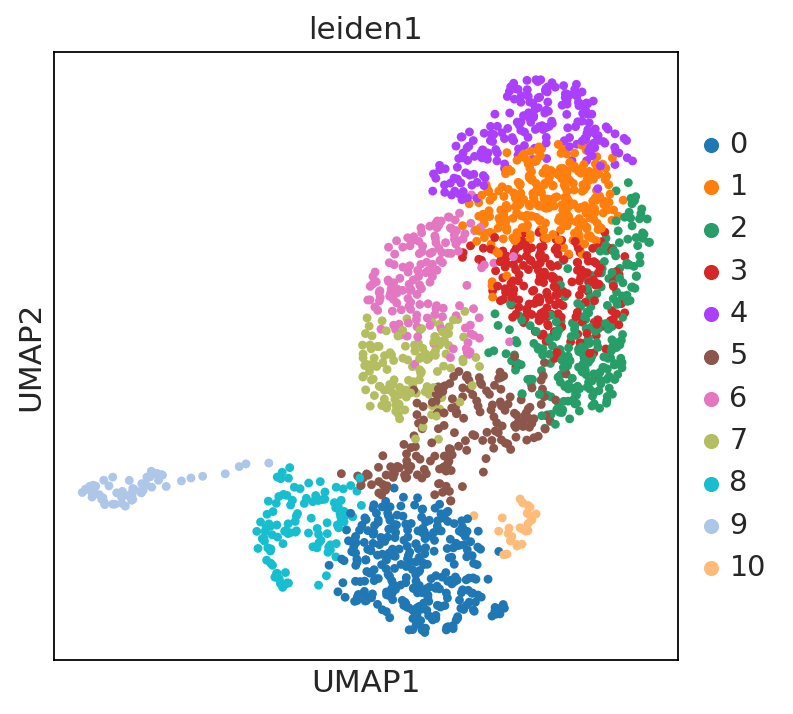

In [50]:
sc.pl.umap(adata,color='leiden1')

In [51]:
#quick look at leiden resolution 0.5
sc.tl.leiden(adata,resolution=0.5,key_added='leiden0.5')

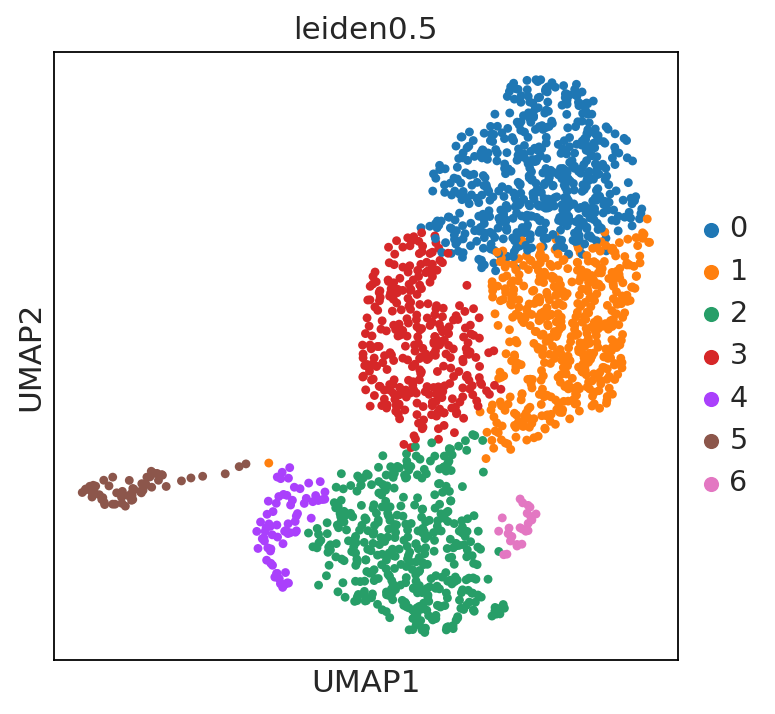

In [52]:
sc.pl.umap(adata,color='leiden0.5')

In [55]:
pd.crosstab(adata.obs['leiden1'],adata.obs.fine_predicted_labels_uncertflagged)

fine_predicted_labels_uncertflagged,DC_cDC2,Doublets,Macrophage,Mast,Mono/neutrophil_MPO,Monocyte,Unknown
leiden1,,,,,,,
0,0,0,0,0,185,45,59
1,0,0,0,0,0,280,7
2,1,0,0,0,0,249,4
3,0,0,0,0,0,208,0
4,14,0,2,0,0,129,54
5,0,0,0,0,4,156,20
6,0,0,0,0,0,153,0
7,0,1,0,0,0,130,0
8,1,3,0,1,56,0,45


In [56]:
pd.crosstab(adata.obs['leiden0.5'],adata.obs.fine_predicted_labels_uncertflagged)

fine_predicted_labels_uncertflagged,DC_cDC2,Doublets,Macrophage,Mast,Mono/neutrophil_MPO,Monocyte,Unknown
leiden0.5,,,,,,,
0,14,0,2,0,0,477,64
1,1,1,0,0,0,483,2
2,0,0,0,0,216,94,88
3,0,1,0,0,0,297,0
4,1,3,0,1,29,0,35
5,0,59,0,0,0,0,0
6,0,0,0,0,1,23,1


In [57]:
#Use Leiden resolution 0.5
unknown = adata.obs[['leiden0.5','fine_predicted_labels_uncertflagged']]

In [58]:
unknown = unknown[unknown['fine_predicted_labels_uncertflagged'].isin(['Unknown'])]

In [59]:
unknown

,leiden0.5,fine_predicted_labels_uncertflagged
index,,
AACCATGCAGGGCATA-HCA_A_GT12934997,2,Unknown
AACTCTTCACTTCTGC-HCA_A_GT12934997,2,Unknown
AAGGAGCAGGCGACAT-HCA_A_GT12934997,2,Unknown
ACGAGCCCAGCTGTTA-HCA_A_GT12934997,2,Unknown
ACTGTCCAGGACCACA-HCA_A_GT12934997,2,Unknown
...,...,...
GAAACTCTCTGCTTGC-HT-243_small-intestine,2,Unknown
TATCAGGAGTGGGCTA-HT-243_small-intestine,0,Unknown
CTGAAGTTCGCGTTTC-PT-64_2,6,Unknown


/home/jovyan/my-conda-envs/standard_plotting/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


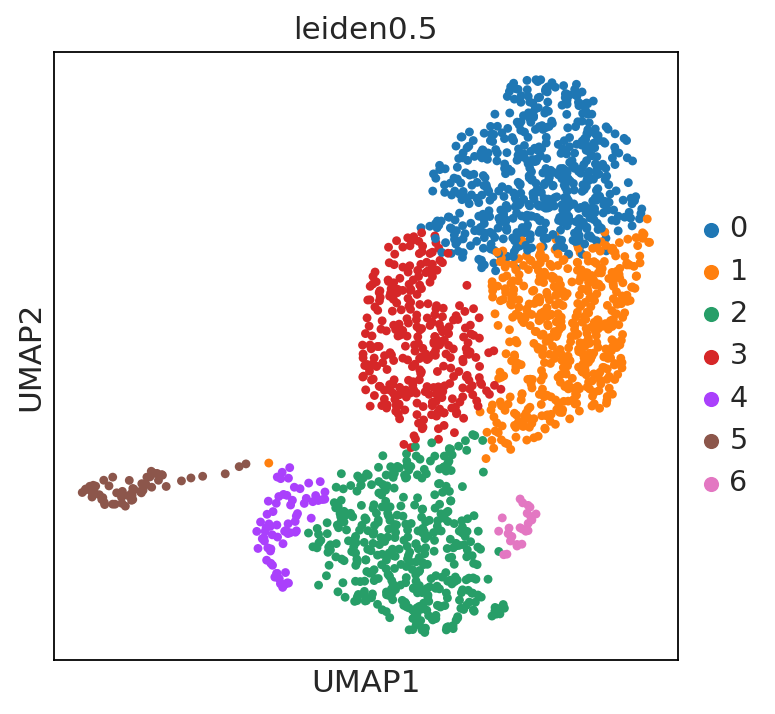

In [60]:
sc.pl.umap(adata,color='leiden0.5')

/home/jovyan/my-conda-envs/standard_plotting/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


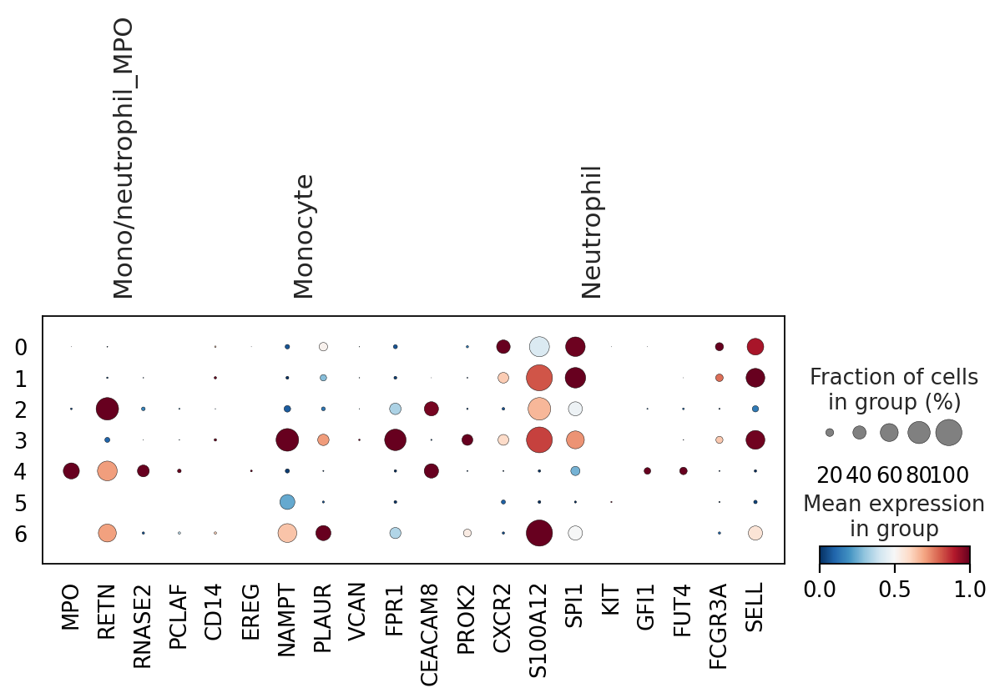

In [61]:
sc.pl.dotplot(adata,var_names=marker_genes_dict,groupby='leiden0.5',color_map='RdBu_r', standard_scale='var')

In [77]:
pd.crosstab(adata.obs.leiden1,adata.obs.fine_predicted_labels_uncertflagged)

fine_predicted_labels_uncertflagged,DC_cDC1,DC_cDC2,DC_langerhans,DC_migratory,DC_pDC,Doublets,Eosinophil/basophil,Erythrocytes,Macrophage,Macrophage_LYVE1,Macrophage_MMP9,Macrophage_TREM2,Mast,Mono/neutrophil_MPO,Monocyte,Unknown
leiden1,,,,,,,,,,,,,,,,
0,0,156,0,0,0,3,0,0,17,3,0,69,0,1,1321,430
1,0,0,0,0,0,1,1,0,0,0,0,0,1858,0,0,1
2,0,1,0,0,0,23,0,0,248,7,98,1093,0,0,12,321
3,0,0,0,0,0,3,13,0,0,0,0,0,1736,0,0,5
4,0,29,0,0,0,1,0,0,1365,62,10,51,0,0,0,109
5,0,36,0,8,0,2,0,3,290,1,0,61,0,0,911,175
6,5,1315,109,0,2,7,0,0,1,0,0,0,0,0,19,27
7,0,18,0,0,0,4,0,0,2,1,0,0,0,0,1408,13
8,0,657,0,0,0,1,0,0,305,0,6,2,0,0,39,108


In [62]:
unknown_adata = adata[adata.obs['fine_predicted_labels_uncertflagged'].isin(['Unknown'])].copy()

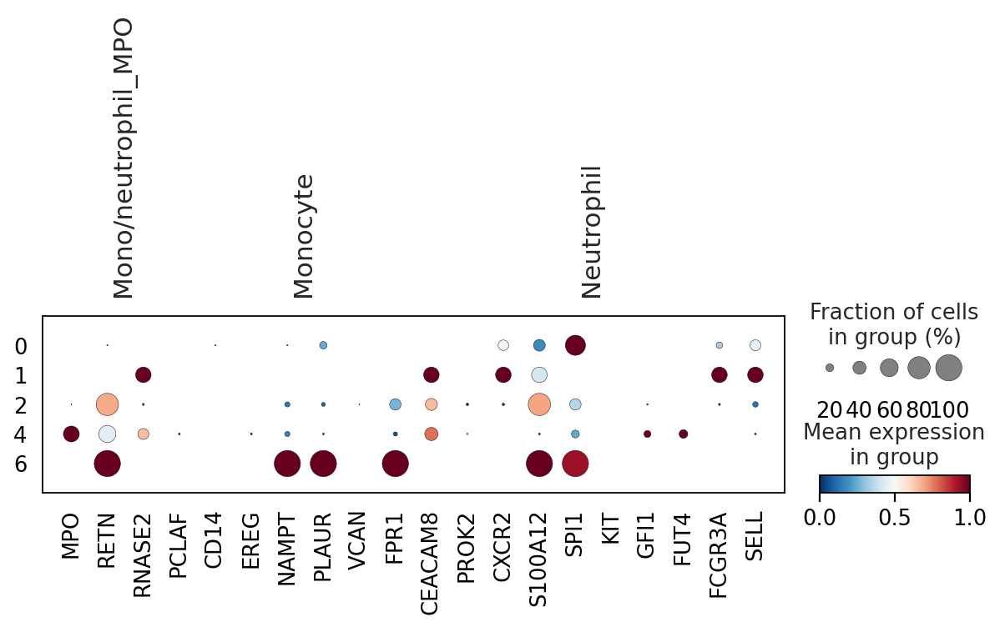

In [63]:
sc.pl.dotplot(unknown_adata,var_names=marker_genes_dict,groupby='leiden0.5',color_map='RdBu_r', standard_scale='var')

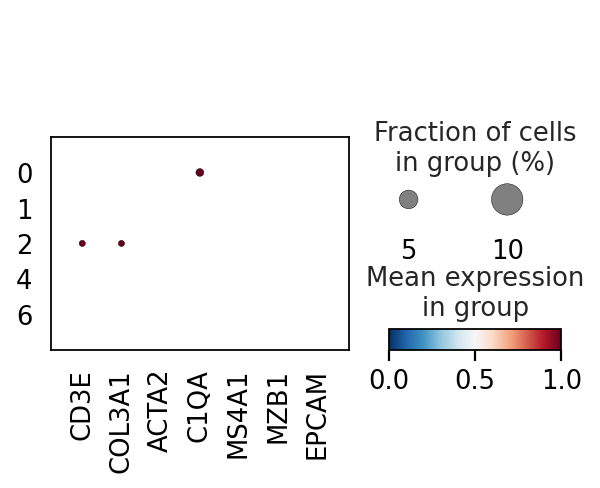

In [64]:
#plot some doublet markers
sc.pl.dotplot(unknown_adata,var_names=['CD3E','COL3A1','ACTA2','C1QA','MS4A1','MZB1','EPCAM'],groupby='leiden0.5',color_map='RdBu_r', standard_scale='var')

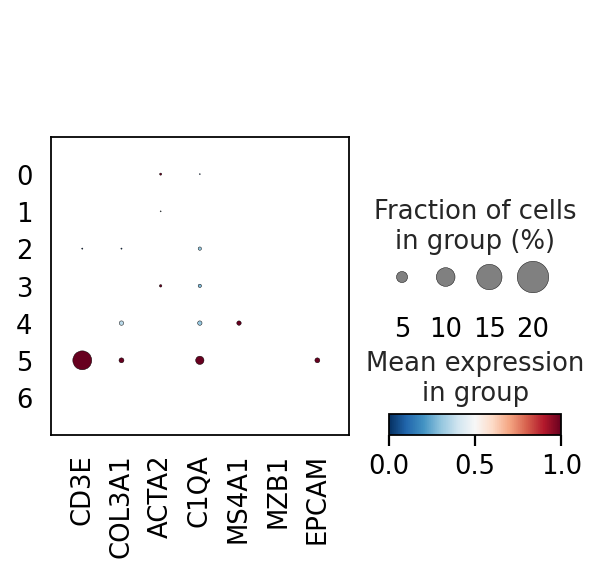

In [65]:
#plot some doublet markers
sc.pl.dotplot(adata,var_names=['CD3E','COL3A1','ACTA2','C1QA','MS4A1','MZB1','EPCAM'],groupby='leiden0.5',color_map='RdBu_r', standard_scale='var')

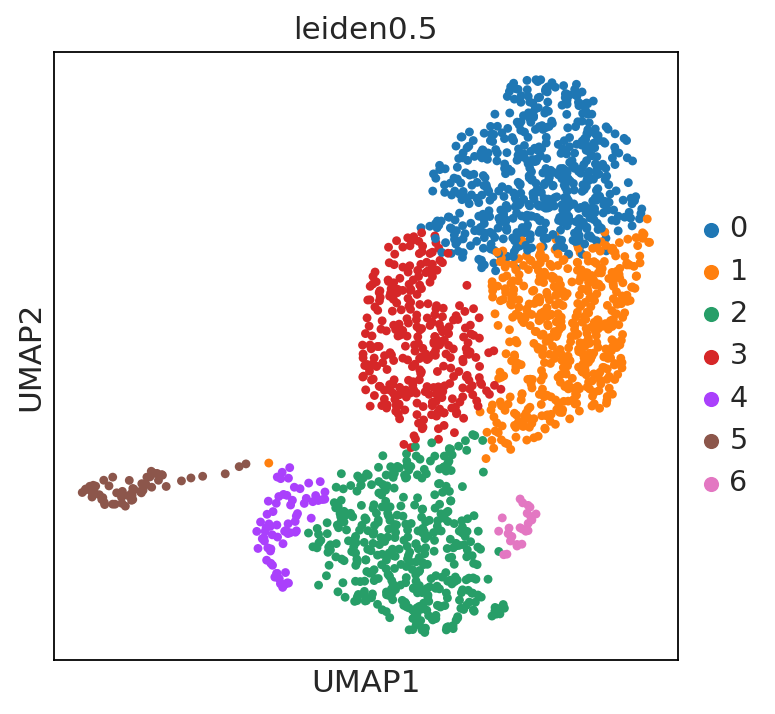

In [66]:
sc.pl.umap(adata,color='leiden0.5')

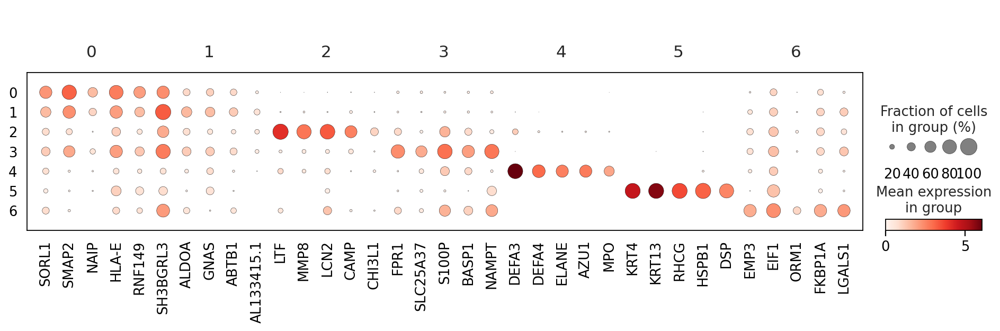

In [67]:
import sys
sys.path.append("/home/jovyan/ao15/Megagut/")
from re5_combine import *
adata.raw = adata.copy()
mkst = calc_marker_stats(adata, groupby="leiden0.5")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(adata, groupby='leiden0.5', mks=mks)

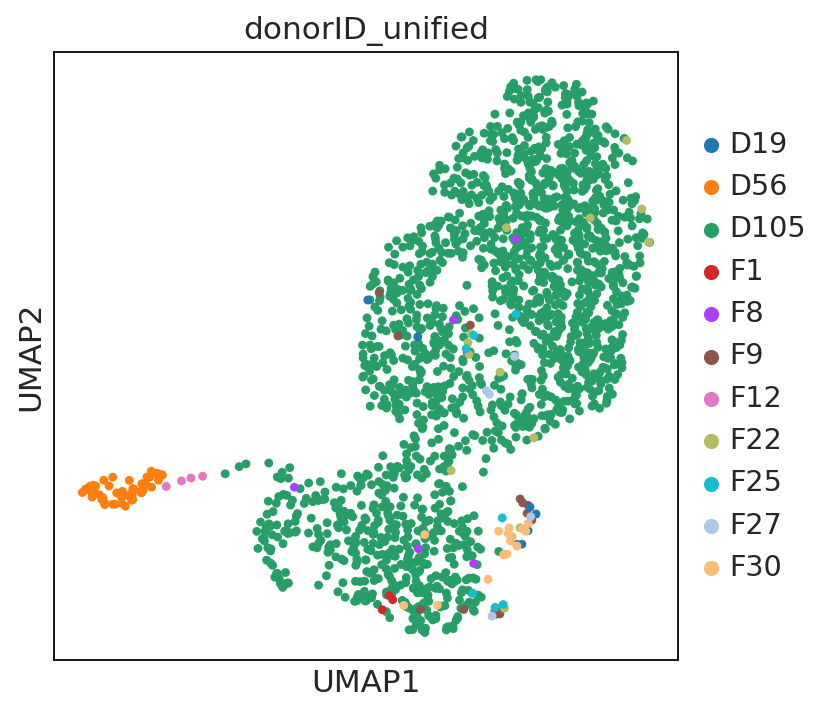

In [68]:
sc.pl.umap(adata,color='donorID_unified')

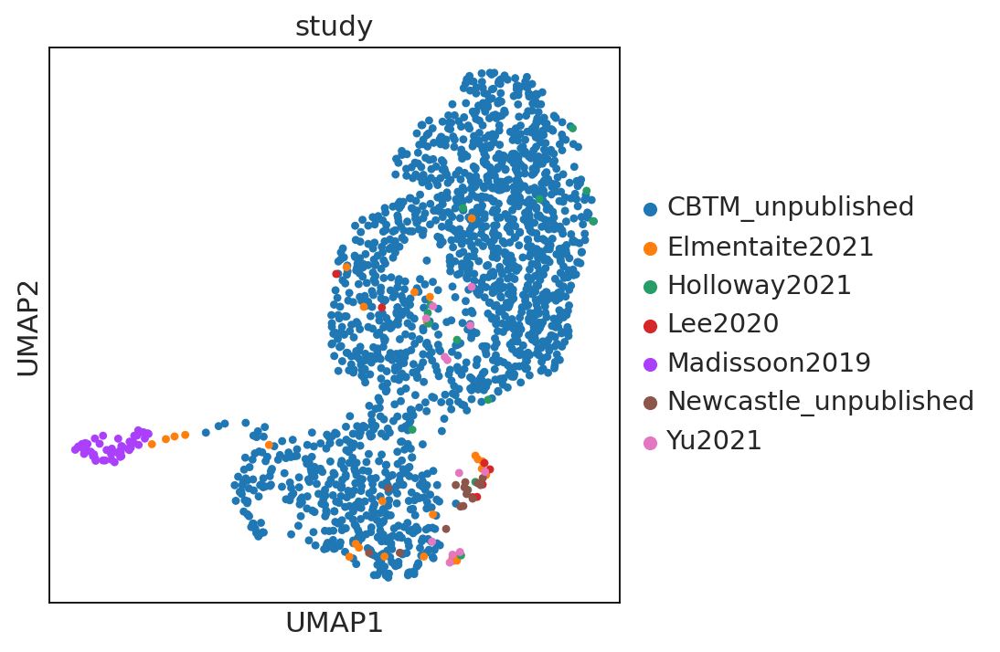

In [69]:
sc.pl.umap(adata,color='study')

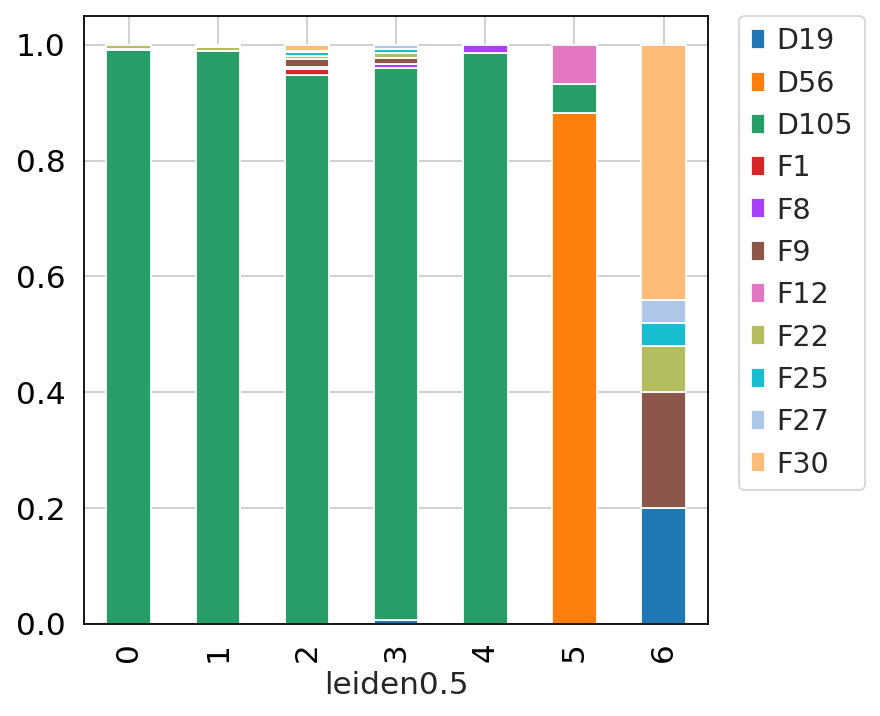

In [70]:
tmp = pd.crosstab(adata.obs['leiden0.5'], adata.obs['donorID_unified'],normalize='index'
                                                                         )
tmp.plot.bar(stacked=True).legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)

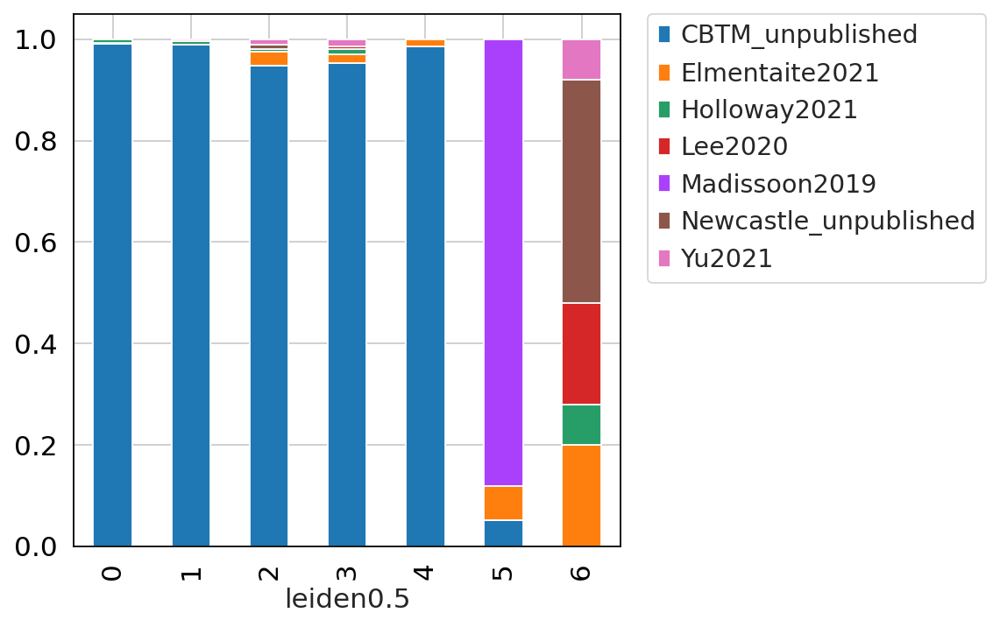

In [71]:
tmp = pd.crosstab(adata.obs['leiden0.5'], adata.obs['study'],normalize='index'
                                                                         )
tmp.plot.bar(stacked=True).legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)

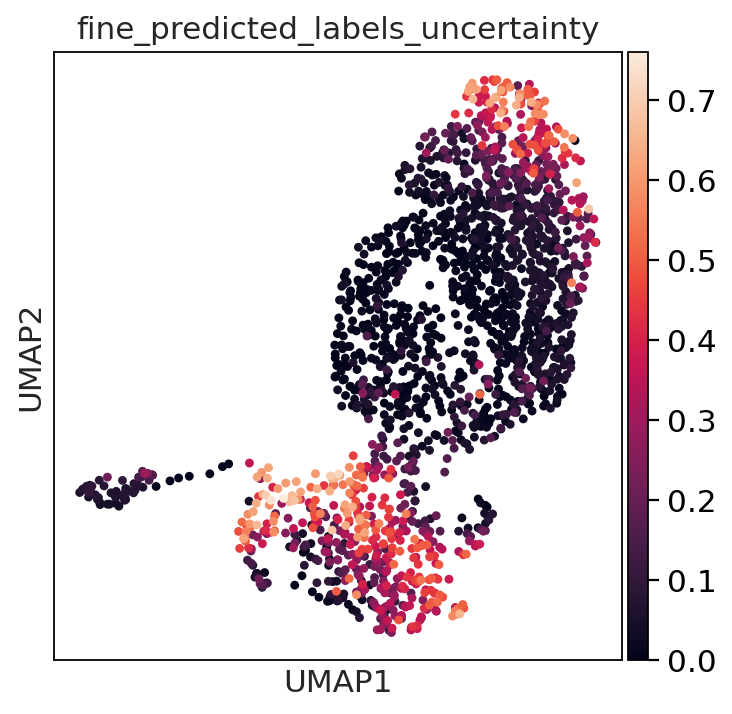

In [72]:
sc.pl.umap(adata,color='fine_predicted_labels_uncertainty',save='neutrophils_scanvi_knnpred_uncertscore.pdf')

In [75]:
pd.crosstab(adata.obs['leiden0.5'],adata.obs.fine_predicted_labels_uncertflagged)

fine_predicted_labels_uncertflagged,DC_cDC2,Doublets,Macrophage,Mast,Mono/neutrophil_MPO,Monocyte,Unknown
leiden0.5,,,,,,,
0,14,0,2,0,0,477,64
1,1,1,0,0,0,483,2
2,0,0,0,0,216,94,88
3,0,1,0,0,0,297,0
4,1,3,0,1,29,0,35
5,0,59,0,0,0,0,0
6,0,0,0,0,1,23,1


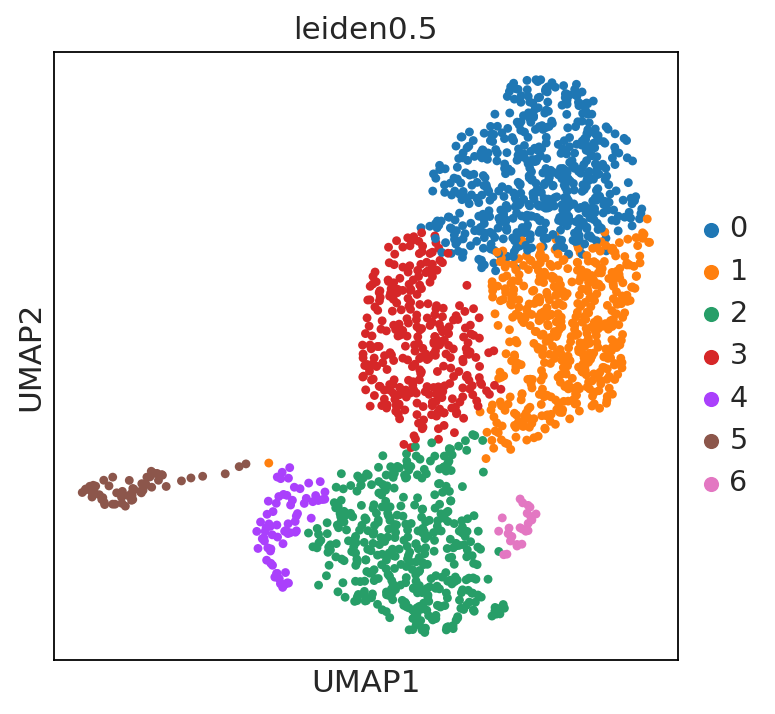

In [76]:
sc.pl.umap(adata,color='leiden0.5')

In [206]:
adata.obs['fine_predicted_labels_resolved'] = (adata.obs['leiden0.5']
        .map(lambda x:{'0':'Neutrophil_circulating',
                       '1':'Neutrophil_circulating',
                       '2':'Neutrophil_mature',
                       '3':'Neutrophil_circulating', 
                       '4':'Neutrophil_mature',
                       '5':'Doublets', 
                       '6':'Neutrophil_fetal',
                       
                         }.get(x,x)).astype('category'))

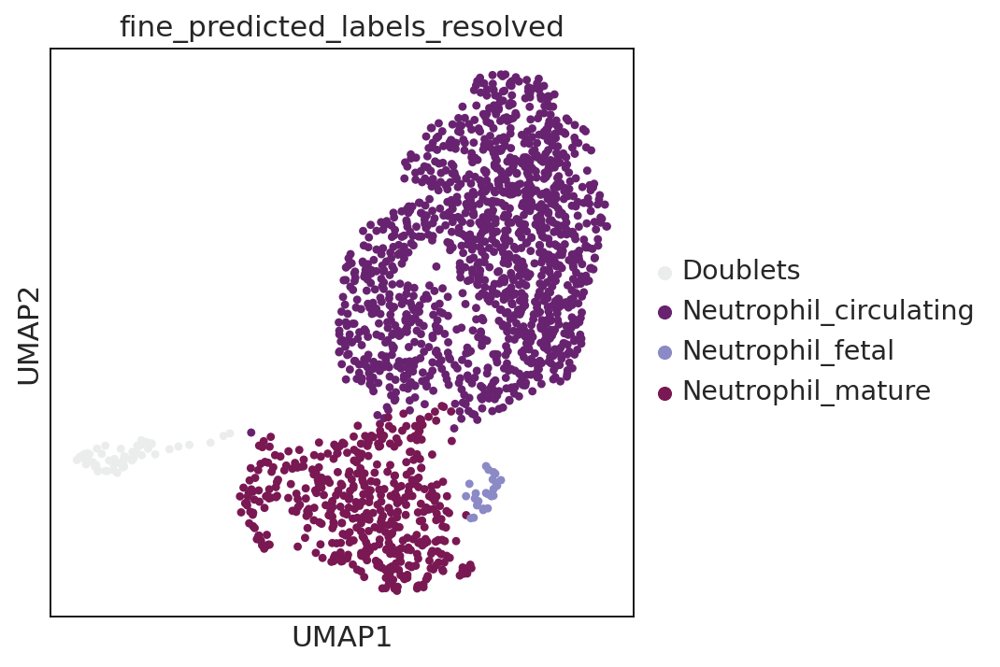

In [212]:
sc.pl.umap(adata,color='fine_predicted_labels_resolved',palette = ['#ebeded',#doublets
    
    
    '#682370',#neutrophil_circulating
    '#8b89c6', #neutrophil_fetal
                                                                   '#7a1853',#neutrophil_mature
],
           save='neutrophils_scanvi_knnpred_resolved.pdf')

In [208]:
adata

AnnData object with n_obs × n_vars = 1893 × 36601
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_spli

In [209]:
no_doublets = adata[~adata.obs.fine_predicted_labels_resolved.isin(['Doublets'])].copy()

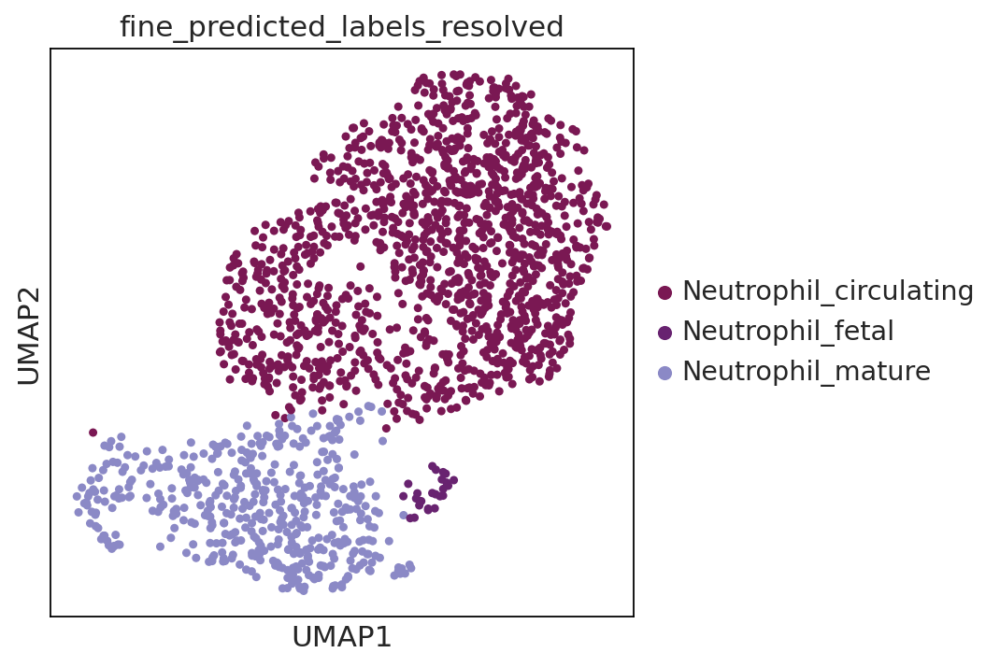

In [213]:
sc.pl.umap(no_doublets,color='fine_predicted_labels_resolved')

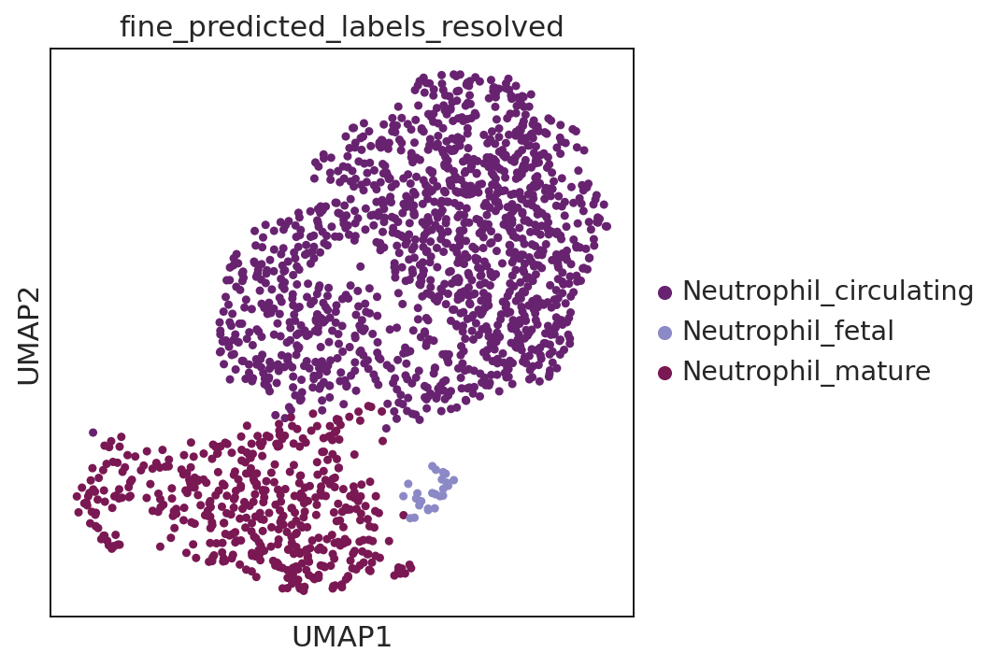

In [214]:
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(no_doublets,color='fine_predicted_labels_resolved',palette = [
    
  
    '#682370',#neutrophil_circulating
    '#8b89c6', #neutrophil_fetal
      '#7a1853',#neutrophil_mature
    
                                              ],save='neutrophils_scanvi_knnpred_resolved_nodoublets.pdf')

In [215]:
annot = adata.obs[['fine_predicted_labels_uncertflagged','fine_predicted_labels_resolved']]

In [216]:
annot

,fine_predicted_labels_uncertflagged,fine_predicted_labels_resolved
index,,
AAACCTGCAACTGCGC-HCA_A_GT12934997,Monocyte,Neutrophil_circulating
AAACCTGCATGGTAGG-HCA_A_GT12934997,Monocyte,Neutrophil_circulating
AAAGATGAGGACAGCT-HCA_A_GT12934997,Monocyte,Neutrophil_circulating
AAAGTAGTCAACGAAA-HCA_A_GT12934997,Monocyte,Neutrophil_circulating
AACACGTAGAGACTAT-HCA_A_GT12934997,Monocyte,Neutrophil_circulating
...,...,...
CTACATTGTCTGCCAG-HT228-fetal-ileum,Mono/neutrophil_MPO,Neutrophil_mature
CTCGTCATCACCTTAT-HT228-fetal-ileum,Mono/neutrophil_MPO,Neutrophil_mature
TGACAACAGAAGGGTA-HT228-fetal-ileum,Monocyte,Neutrophil_circulating


In [217]:
annot.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/disease_annot/resolved_annot/Myeloid_neutrophils_annot20231207.csv')

In [92]:
mye_disease = sc.read_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/disease/compartments/Myeloid_pooled_disease.gene_cellbender.good_qc_cluster_mito80.stringent_doublet_removed.hvg7500_noCC.scvi_output.lv20_batch256.with_raw_counts.scArches_broad_pred.20230124.h5ad')

In [93]:
mye_scanvi = pd.read_csv('/nfs/team205/ao15/Megagut/Annotations_v3/metadata/X_scANVI/disease/disease_fine_annot_predict_Myeloid_20230226.csv.gz',compression='gzip',index_col=0)

In [94]:
mye_disease.obsm['X_scANVI'] = mye_scanvi

In [95]:
mye_disease

AnnData object with n_obs × n_vars = 18221 × 36601
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_spl

In [96]:
adata

AnnData object with n_obs × n_vars = 1893 × 36601
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_spli

In [97]:
adata.obs['level_3_annot'] = adata.obs.fine_predicted_labels_resolved

In [98]:
reference = sc.read_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/pre_scvi20221124_updated_donorID_20230126/with_doublets/pooled_healthy.lv20_batch256.with_broad_annotation.20220917.with_countlayers.20221124.Myeloid.20230126.h5ad')

In [99]:
reference

AnnData object with n_obs × n_vars = 37393 × 36601
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_spl

In [100]:
reference.obs.fine_annot.value_counts()

Macrophage                8594
DC_cDC2                   6381
Mast                      5607
Doublets                  4180
Monocyte                  3792
Macrophage_LYVE1          3627
Macrophage_TREM2          1511
DC_cDC1                    946
Macrophage_MMP9            907
DC_pDC                     565
DC_migratory               417
Erythrocytes               350
Mono/neutrophil_MPO        178
DC_langerhans              164
Macrophage_CD5L            100
Eosinophil/basophil         70
Megakaryocyte/platelet       4
Name: fine_annot, dtype: int64

In [101]:
scanvi_ref = pd.read_csv('/nfs/team205/ao15/Megagut/Annotations_v3/models/scanvi_compartments/Myeloid_hvg5000.noCC_scvi.scanvi_fine_annot.20230226.csv.gz',compression='gzip',index_col=0)

In [102]:
scanvi_ref

,LV1,LV2,LV3,LV4,LV5,LV6,LV7,LV8,LV9,LV10,LV11,LV12,LV13,LV14,LV15,LV16,LV17,LV18,LV19,LV20
index,,,,,,,,,,,,,,,,,,,,
AAACGCTAGCGACCCT-GSM4600896,-0.029375,0.598412,0.074087,-0.137727,1.263821,0.124621,-0.035878,0.288551,1.095610,-0.144275,-0.017269,-1.828688,0.023520,-0.101623,0.065990,1.976230,-0.711546,0.730882,0.287919,0.056095
AAAGGGCAGTCACACT-GSM4600896,-0.036976,0.498846,0.082328,-0.121302,2.019891,0.137434,-0.032392,-0.203248,1.343846,-0.196210,-0.028496,-1.695960,-0.007679,-0.124085,0.055898,0.734803,0.281928,0.510984,0.403333,0.009518
AAAGGGCCAACACAGG-GSM4600896,-0.222939,-0.784251,0.012773,-0.253297,0.447109,-3.342697,-0.071255,-0.046597,-1.190531,-0.182178,0.075084,-1.371584,0.085910,-0.212031,-0.038512,-1.133625,1.070159,0.103679,1.218980,0.616137
AAAGTCCGTCGAAGCA-GSM4600896,-0.040166,0.208586,0.075654,-0.118172,1.361113,0.257864,-0.036177,-0.090816,0.782147,-0.080299,-0.010892,-2.149660,0.002015,-0.057738,-0.005992,0.889079,-0.800602,0.486683,-0.233410,0.441300
AAAGTGACACCCATAA-GSM4600896,-0.086671,0.774538,0.042071,-0.076656,1.404197,0.399673,-0.038933,-1.371565,0.500224,-0.060172,-0.042539,-2.294494,-0.002884,0.001888,-0.009952,1.053782,-0.709229,-0.161011,-0.594445,0.316283
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TCTTTCCTCCTGCAGG-GSM5525958,-0.042964,-1.354237,-0.037096,-0.068821,0.841769,0.887550,0.027339,-0.705557,0.050462,-0.046727,0.007477,-0.011443,0.068615,0.121413,-0.032975,-0.932305,-0.043650,-0.076635,-0.224351,-0.324805
TGAGCCGTCTTGAGGT-GSM5525958,-0.005315,-0.838935,0.008191,-0.066718,-0.206473,-0.274866,-0.003288,-1.118631,0.522161,0.002127,-0.011243,0.968082,0.040222,0.068800,0.090801,0.803508,-0.662949,-0.977344,-0.179212,0.064305
TGGCTGGCAATACGCT-GSM5525958,-0.059708,-0.009673,0.062703,-0.111497,-0.826880,-1.385922,-0.059768,-1.405210,0.603722,0.183278,0.082135,0.210807,-0.000286,0.042226,0.091518,-0.131342,-0.263850,0.614054,-1.214533,0.430498


In [103]:
reference.obsm['X_scANVI'] = scanvi_ref

In [104]:
mye_disease_annot = pd.read_csv('/nfs/team205/ao15/Megagut/Annotations_v3/disease_annot/resolved_annot/Myeloid_disease_annot.csv',index_col=0)

In [105]:
mye_disease_annot

,fine_predicted_labels_uncertflagged,fine_predicted_labels_resolved
index,,
AACGTTGCACATCCGG-4918STDY7273964,DC_cDC2,DC_cDC2
AACGTTGGTCTGGTCG-4918STDY7273964,Doublets,Doublets
ACACCCTTCCACTGGG-4918STDY7273964,DC_cDC2,DC_cDC2
ACCGTAATCCAGTAGT-4918STDY7273964,Mast,Mast
ACGGAGAAGGCCATAG-4918STDY7273964,Monocyte,Monocyte
...,...,...
TTCTACACAAAGGTGC-GSM4546346,Monocyte,Monocyte
TTGCCGTCACCTCGGA-GSM4546346,DC_pDC,DC_pDC
TTGCCGTCATCCTTGC-GSM4546346,DC_cDC2,DC_cDC2


In [106]:
mye_disease.obs['fine_predicted_labels_uncertflagged'] = mye_disease_annot.fine_predicted_labels_uncertflagged
mye_disease.obs['fine_predicted_labels_resolved'] = mye_disease_annot.fine_predicted_labels_resolved
mye_disease.obs['level_3_annot'] = mye_disease_annot.fine_predicted_labels_resolved

In [107]:
reference.obs['level_3_annot'] = reference.obs.fine_annot

In [108]:
adata.obs.level_3_annot.value_counts()

Neutrophil_circulating    1342
Neutrophil_activated       467
Doublets                    59
Neutrophil_fetal            25
Name: level_3_annot, dtype: int64

In [129]:
adata.X = adata.layers['counts']

In [151]:
adata.layers['counts'].max()

8.76803

In [152]:
cdata = sc.read_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/neutrophils/pooled_healthy.gene_cellbender.bad_qc_cluster_mito80.neutrophil.20221013.h5ad')

In [153]:
cdata.X.max()

1277.0

In [154]:
adata.X = cdata.X

In [155]:
adata.X.max()

1277.0

In [156]:
bdata = reference.concatenate(mye_disease)

In [157]:
bdata = bdata.concatenate(adata)

In [158]:
mye_disease

AnnData object with n_obs × n_vars = 18221 × 36601
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_spl

In [159]:
adata

AnnData object with n_obs × n_vars = 1893 × 36601
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_spli

In [160]:
reference

AnnData object with n_obs × n_vars = 37393 × 36601
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_spl

In [161]:
37393+1893+18221

57507

In [162]:
bdata

AnnData object with n_obs × n_vars = 57507 × 36601
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_spl

In [163]:
sc.pp.neighbors(bdata, use_rep="X_scANVI")
sc.tl.umap(bdata)

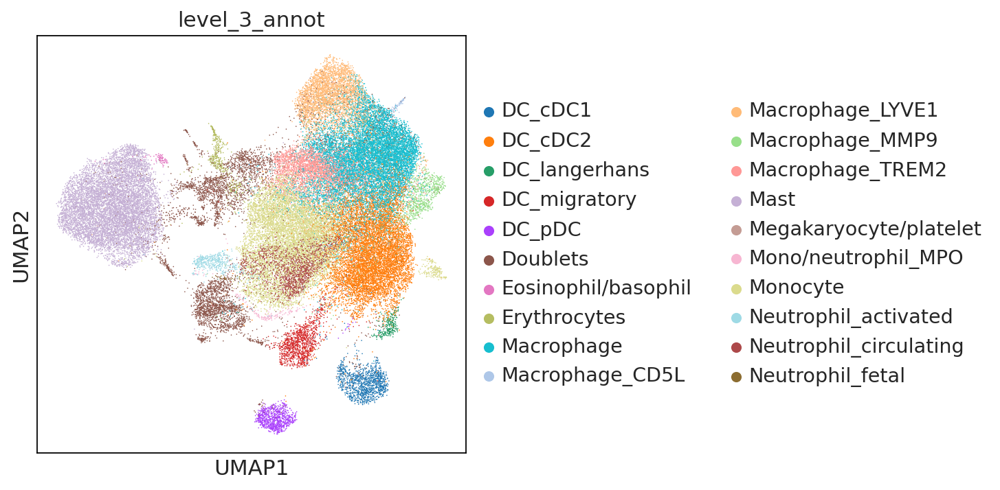

In [164]:
sc.pl.umap(bdata,color='level_3_annot')

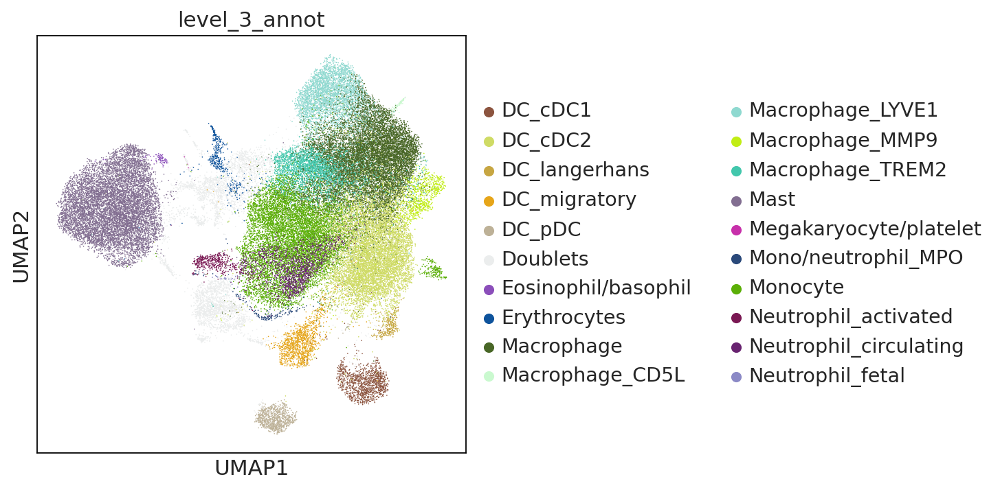

In [165]:
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(bdata,color='level_3_annot',palette = ['#8c543f',#DC_cDC1
'#cfdb65',#DC_cDC2
'#c7a642',#DC_langerhans
'#e6a519',#DC_migratory
'#bdb197',#DC_pDC
 '#ebeded',#doublets
'#8b4eba',#Eosinophil/basophil
'#0e539c',#Erythrocytes
'#486626',#Macrophage
'#caf9cf',#Macrophage_CD5L
'#8fd9d0',#Macrophage_LYVE1
'#c1ed15',#Macrophage_MMP9
'#42c7ac',#Macrophage_TREM2
'#826e91',#Mast
'#c730aa',#Megakaryocyte/platelet
'#2a497a',#Mono/neutrophil_MPO
'#5baf07',#Monocyte 
    
    '#7a1853',#neutrophil_activated
    '#682370',#neutrophil_circulating
    '#8b89c6', #neutrophil_fetal
#'#000000'#unknown
                                                                       ],save='myeloid_pooled.healthy.disease.pdf')

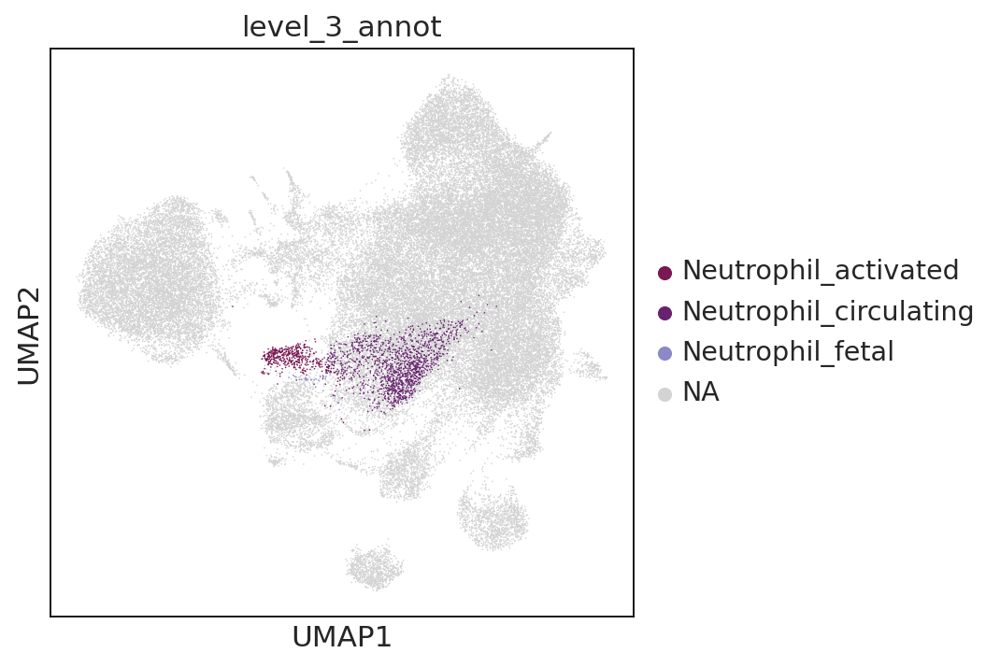

In [166]:
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(bdata,color='level_3_annot',groups=['Neutrophil_activated','Neutrophil_circulating','Neutrophil_fetal'])

In [167]:
bdata.X.max()

13567.0

In [168]:
adata.X.max()

1277.0

In [169]:
reference.X.max()

13567.0

In [170]:
mye_disease.X.max()

11278.0

In [172]:
sc.pp.normalize_total(bdata, target_sum=1e4)
sc.pp.log1p(bdata)

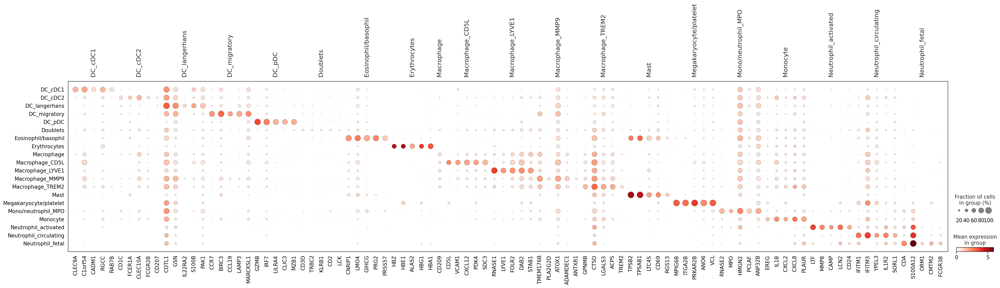

In [174]:
import sys
sys.path.append("/home/jovyan/ao15/Megagut/")
from re5_combine import *
bdata.raw = bdata.copy()
mkst = calc_marker_stats(bdata, groupby="level_3_annot")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(bdata, groupby='level_3_annot', mks=mks)

In [175]:
neutrophil_markers = ['SPI1','KIT','CEACAM8','FUT4','ITGA4','CD101',
                      'SELL','CXCR2','CXCR4','FCGR3A'
                     ]

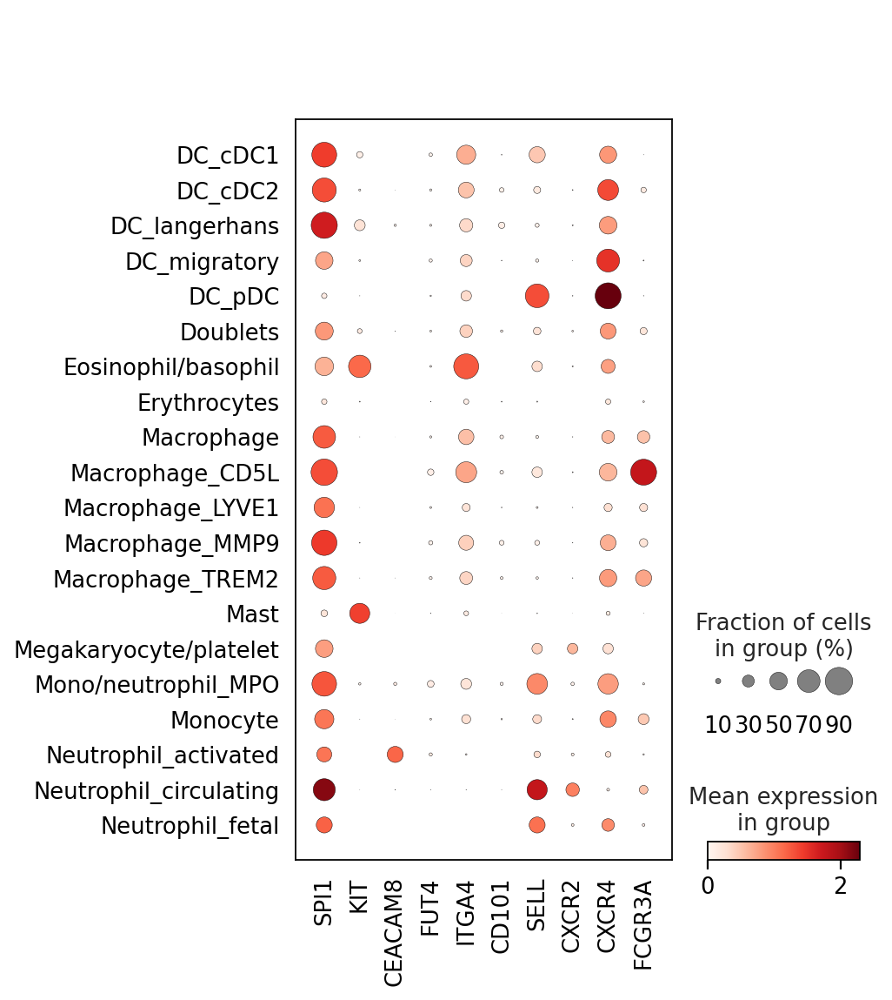

In [176]:
sc.pl.dotplot(bdata,var_names=neutrophil_markers,groupby='level_3_annot')

In [181]:
salas_markers = {'N1':['CXCL8','S100A11','CMTM2','ACTB','PROK2',
                       'S100A8','S100A9','GCA','FCGR3B','OSM','PTGS2','PDE4B',
                       'NFKBIZ','IL1B','TNFAIP3','RHOH','CXCL1','TNFAIP6','FTH1'],
                 'N2':['GABARAPL2','CCL3','CCL4','C15orf48','RALGDS','PI3','CD63',
                       'SQSTM1','CXCR4','CD83','CSTB','LGALS3','PLEKHB2','BHLHE40',
                      'ASAH1','VEGFA'],
                 'N3':['GBP1','GBP5','IFIT3','IFIT2','RNF213','GBP4','PARP14','IRF1',
                      'TAP1','SAMHD1','LACTB','GBP2','APOL6','LAP3','HM13','FFAR2','TNFSF13B',
                      'RSAD2']
                }

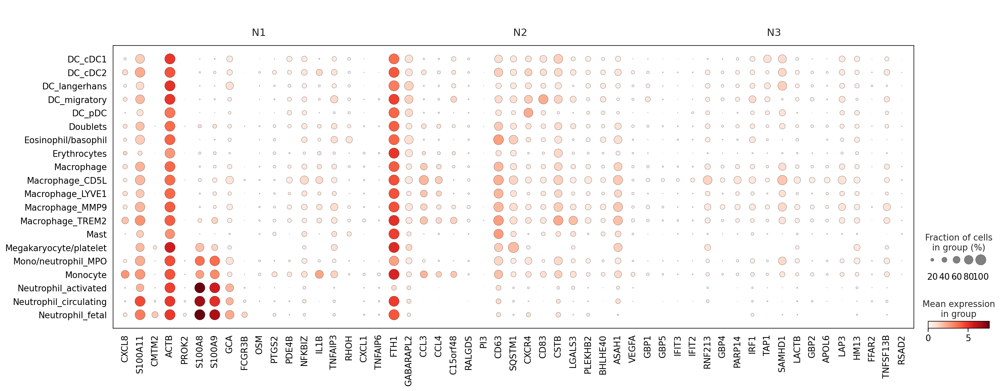

In [182]:
sc.pl.dotplot(bdata,var_names=salas_markers,groupby='level_3_annot')

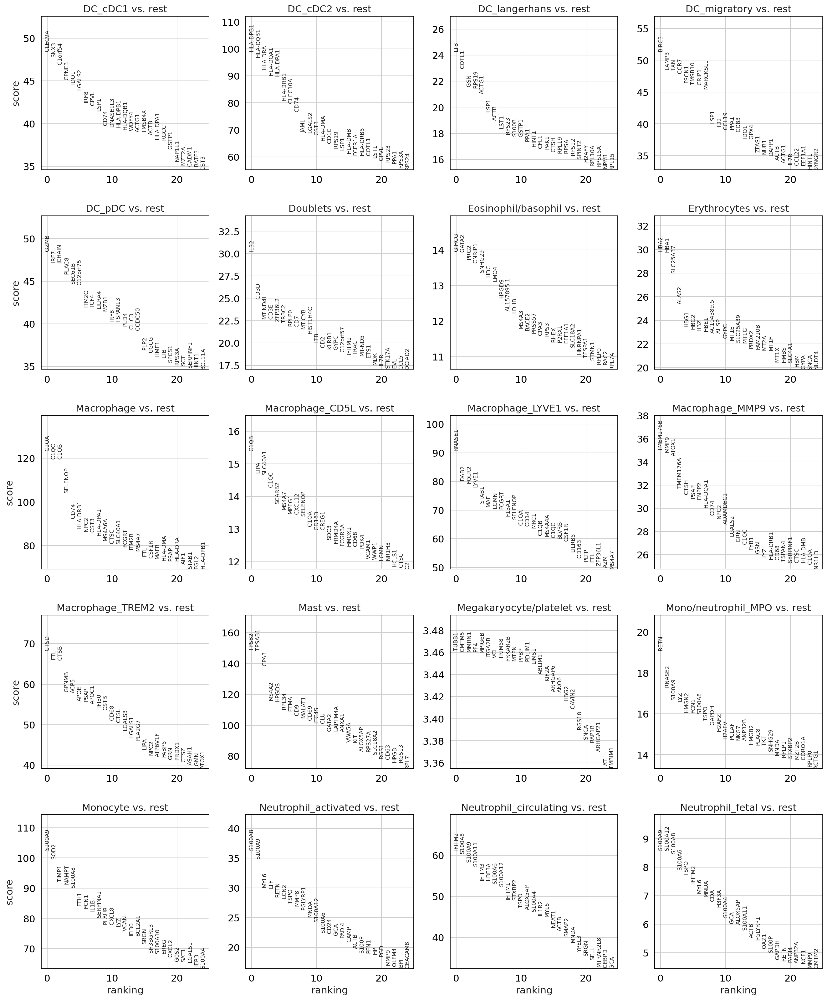

In [183]:
sc.tl.rank_genes_groups(bdata,groupby='level_3_annot',method='wilcoxon')
sc.pl.rank_genes_groups(bdata, n_genes=25, sharey=False)

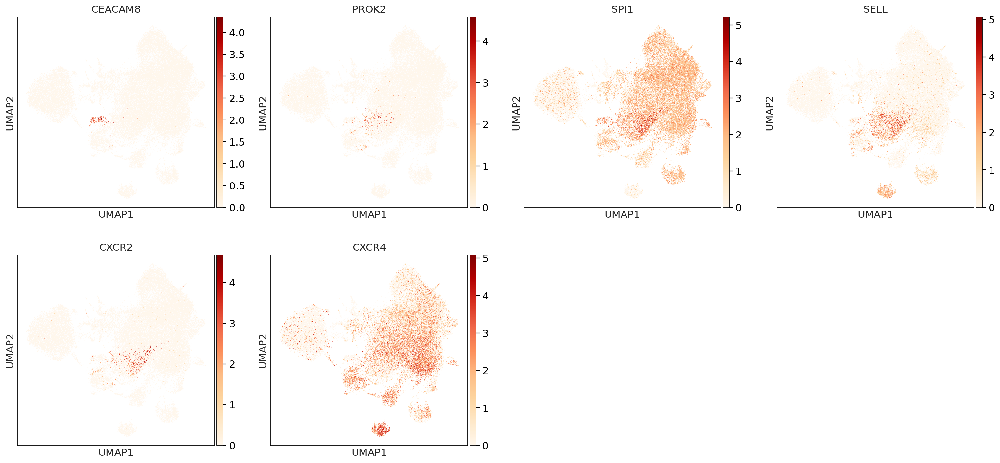

In [185]:
sc.pl.umap(bdata,color=['CEACAM8','PROK2','SPI1','SELL','CXCR2','CXCR4'],cmap='OrRd')

In [186]:
list(bdata.obs.level_3_annot.unique())

['Mast',
 'DC_cDC1',
 'Monocyte',
 'DC_cDC2',
 'Macrophage',
 'Macrophage_MMP9',
 'DC_migratory',
 'Macrophage_LYVE1',
 'Macrophage_TREM2',
 'DC_pDC',
 'Doublets',
 'Megakaryocyte/platelet',
 'Mono/neutrophil_MPO',
 'Macrophage_CD5L',
 'DC_langerhans',
 'Erythrocytes',
 'Eosinophil/basophil',
 'Neutrophil_circulating',
 'Neutrophil_activated',
 'Neutrophil_fetal']

In [187]:
mono_neutro = bdata[bdata.obs.level_3_annot.isin(['Neutrophil_circulating',
 'Neutrophil_activated',
 'Neutrophil_fetal','Mono/neutrophil_MPO','Monocyte'])].copy()

In [188]:
sc.pp.neighbors(mono_neutro, use_rep="X_scANVI")
sc.tl.umap(mono_neutro)

In [191]:
del mono_neutro.uns['level_3_annot_colors']

In [220]:
mono_neutro.obs['level_3_annot'] = (
    mono_neutro.obs["level_3_annot"]
    .map(lambda x: {
 'Neutrophil_activated':'Neutrophil_mature'
         }.get(x, x))
    .astype("category")
)

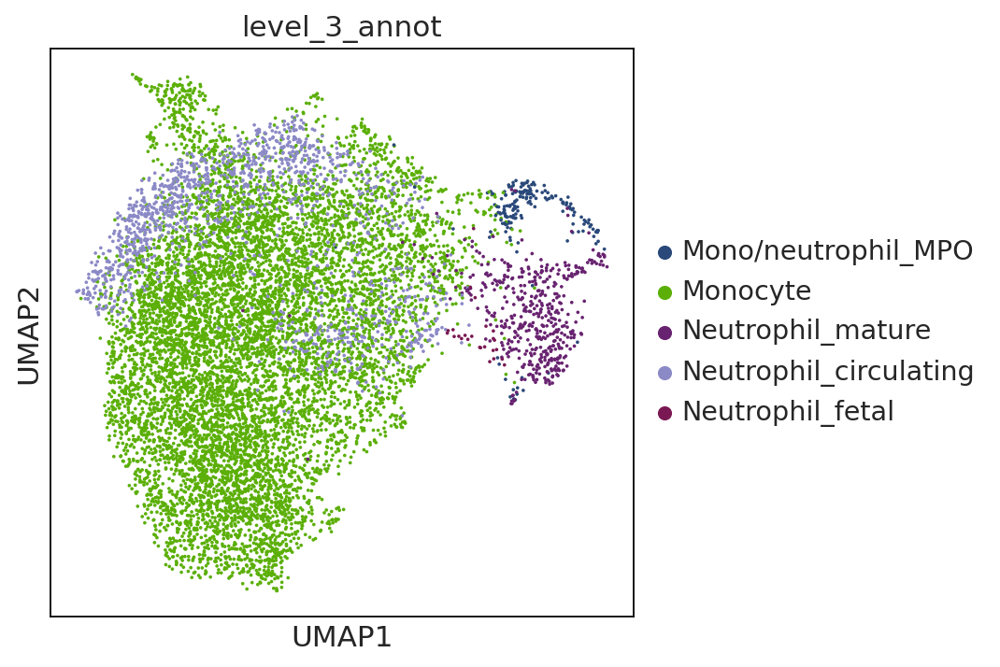

In [221]:
sc.pl.umap(mono_neutro,color='level_3_annot',
          palette = [
'#2a497a',#Mono/neutrophil_MPO
'#5baf07',#Monocyte 
    
   
    '#682370',#neutrophil_circulating
    '#8b89c6', #neutrophil_fetal
                      '#7a1853',#neutrophil_mature
#'#000000'#unknown
                    ],save='mono_neutro_subclustered')

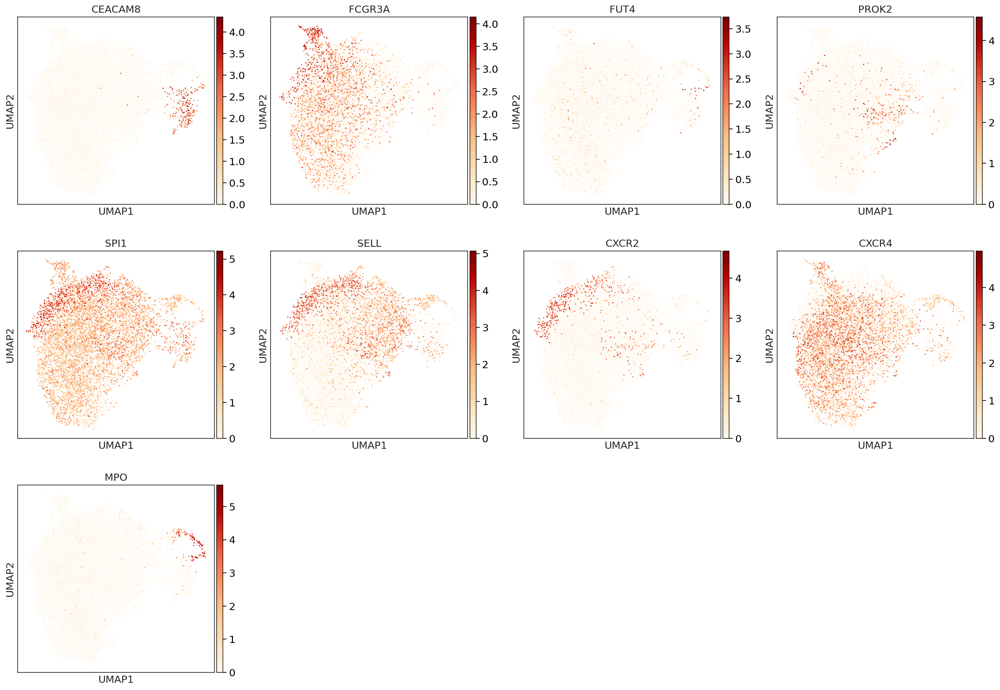

In [223]:
sc.pl.umap(mono_neutro,color=['CEACAM8','FCGR3A','FUT4','PROK2','SPI1','SELL','CXCR2','CXCR4','MPO'],cmap='OrRd',save='mono_neutro_subclustered_markers.pdf')

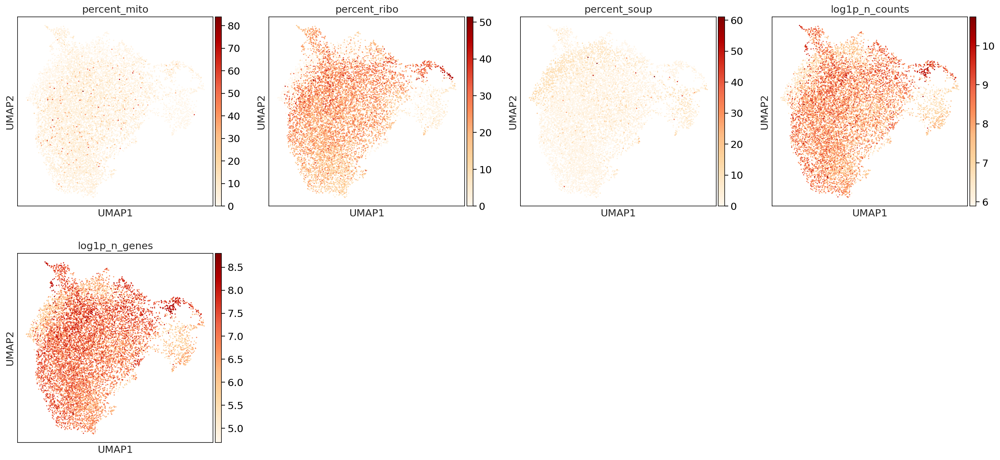

In [224]:
sc.pl.umap(mono_neutro,color=['percent_mito','percent_ribo','percent_soup','log1p_n_counts','log1p_n_genes'],cmap='OrRd',save='mono_neutro_subclustered_qcmetrics.pdf')

In [196]:
sc.tl.leiden(mono_neutro,resolution=1,key_added='leiden1')

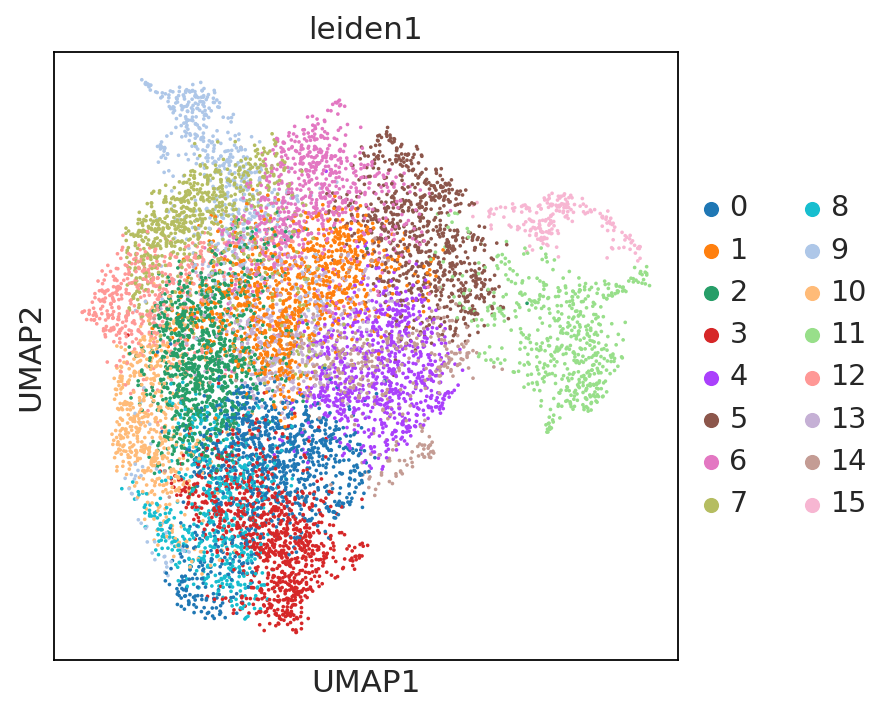

In [197]:
sc.pl.umap(mono_neutro,color='leiden1')

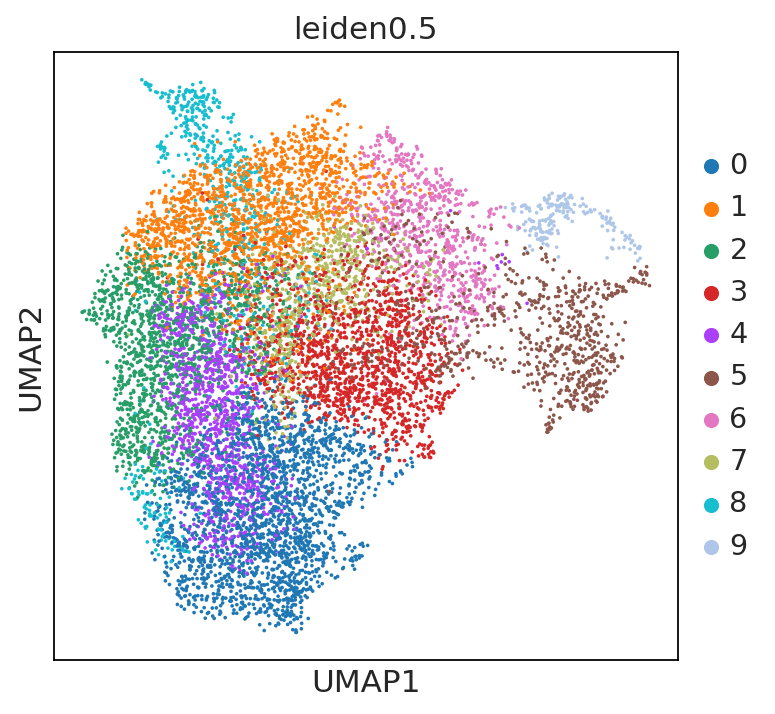

In [199]:
sc.tl.leiden(mono_neutro,resolution=0.5,key_added='leiden0.5')
sc.pl.umap(mono_neutro,color='leiden0.5')

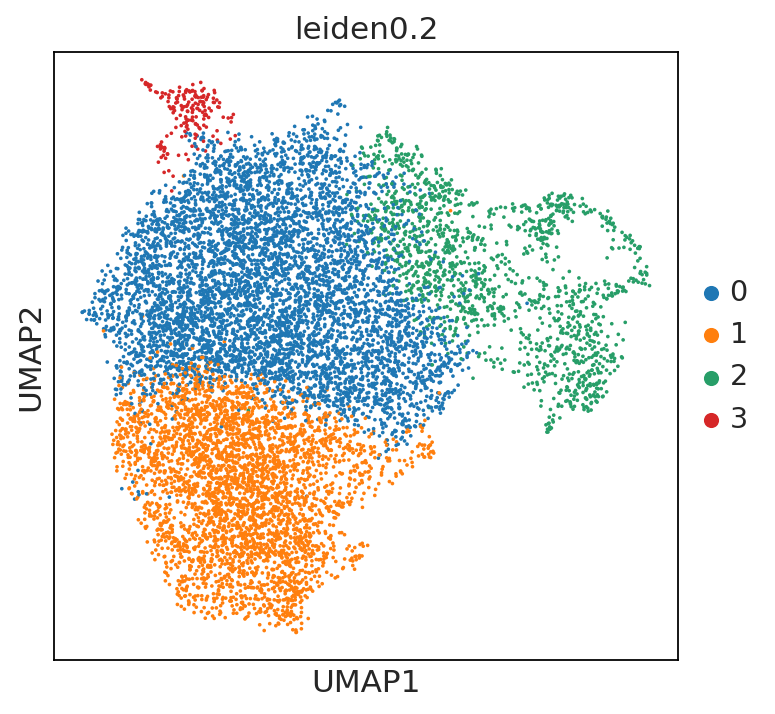

In [201]:
sc.tl.leiden(mono_neutro,resolution=0.2,key_added='leiden0.2')
sc.pl.umap(mono_neutro,color='leiden0.2')

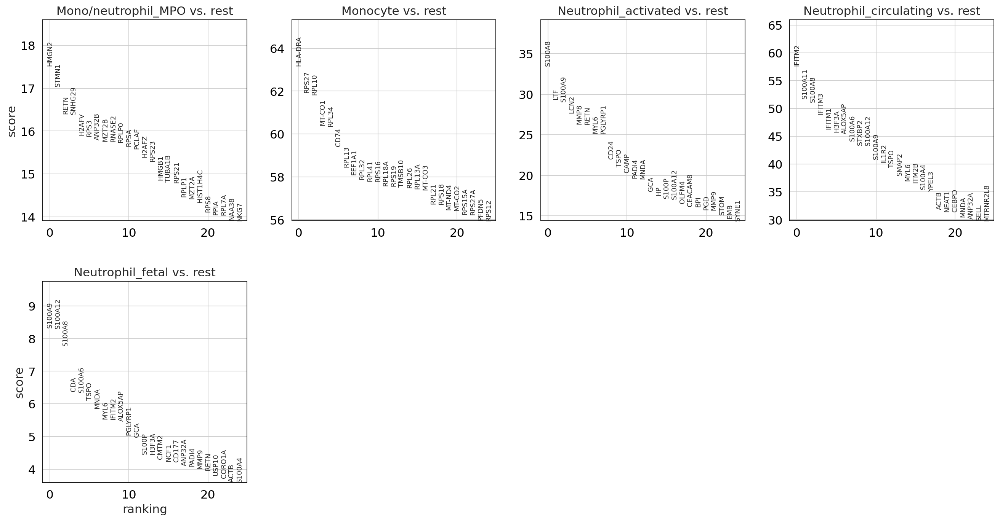

In [200]:
sc.tl.rank_genes_groups(mono_neutro,groupby='level_3_annot',method='wilcoxon')
sc.pl.rank_genes_groups(mono_neutro, n_genes=25, sharey=False)

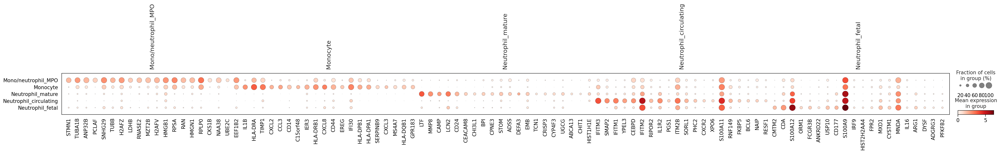

In [229]:
import sys
sys.path.append("/home/jovyan/ao15/Megagut/")
from re5_combine import *
mono_neutro.raw = mono_neutro.copy()
mkst = calc_marker_stats(mono_neutro, groupby="level_3_annot")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(mono_neutro, groupby='level_3_annot', mks=mks, n_genes=20,save='mono_neutro_markerdotplot.pdf')

In [236]:
mono_neutro

AnnData object with n_obs × n_vars = 10988 × 36601
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_spl

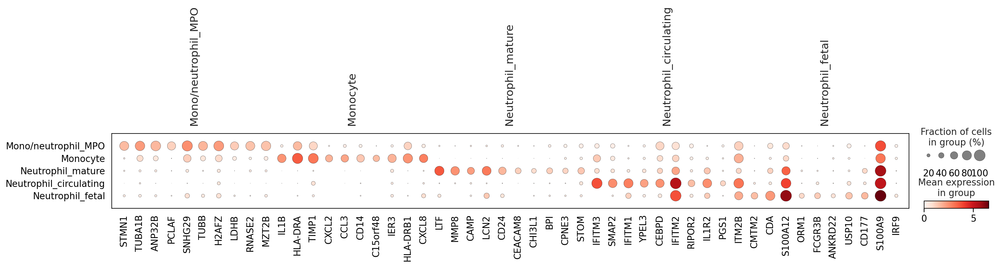

In [237]:
import sys
sys.path.append("/home/jovyan/ao15/Megagut/")
from re5_combine import *
mono_neutro.raw = mono_neutro.copy()
mkst = calc_marker_stats(mono_neutro, groupby="level_3_annot")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(mono_neutro, groupby='level_3_annot', mks=mks, n_genes=10,save='mono_neutro_markerdotplot_smaller.pdf')

In [238]:
mono_neutro

AnnData object with n_obs × n_vars = 10988 × 36601
    obs: 'latent_cell_probability', 'latent_RT_efficiency', 'cecilia22_predH', 'cecilia22_predH_prob', 'cecilia22_predH_uncertain', 'cecilia22_predL', 'cecilia22_predL_prob', 'cecilia22_predL_uncertain', 'elmentaite21_pred', 'elmentaite21_pred_prob', 'elmentaite21_pred_uncertain', 'suo22_pred', 'suo22_pred_prob', 'suo22_pred_uncertain', 'n_counts', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'n_counts_mito', 'percent_ribo', 'n_counts_ribo', 'percent_hb', 'n_counts_hb', 'percent_top50', 'n_counts_raw', 'log1p_n_counts_raw', 'n_genes_raw', 'log1p_n_genes_raw', 'percent_mito_raw', 'n_counts_mito_raw', 'percent_ribo_raw', 'n_counts_ribo_raw', 'percent_hb_raw', 'n_counts_hb_raw', 'percent_top50_raw', 'n_counts_spliced', 'log1p_n_counts_spliced', 'n_genes_spliced', 'log1p_n_genes_spliced', 'percent_mito_spliced', 'n_counts_mito_spliced', 'percent_ribo_spliced', 'n_counts_ribo_spliced', 'percent_hb_spliced', 'n_counts_hb_spl

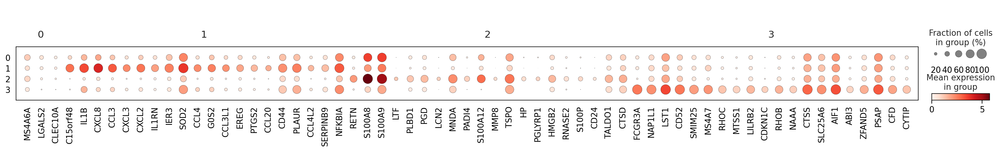

In [205]:
import sys
sys.path.append("/home/jovyan/ao15/Megagut/")
from re5_combine import *
mono_neutro.raw = mono_neutro.copy()
mkst = calc_marker_stats(mono_neutro, groupby="leiden0.2")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(mono_neutro, groupby='leiden0.2', mks=mks, n_genes=20)

In [225]:
bdata.obs['level_3_annot'] = (
    bdata.obs["level_3_annot"]
    .map(lambda x: {
 'Neutrophil_activated':'Neutrophil_mature'
         }.get(x, x))
    .astype("category")
)

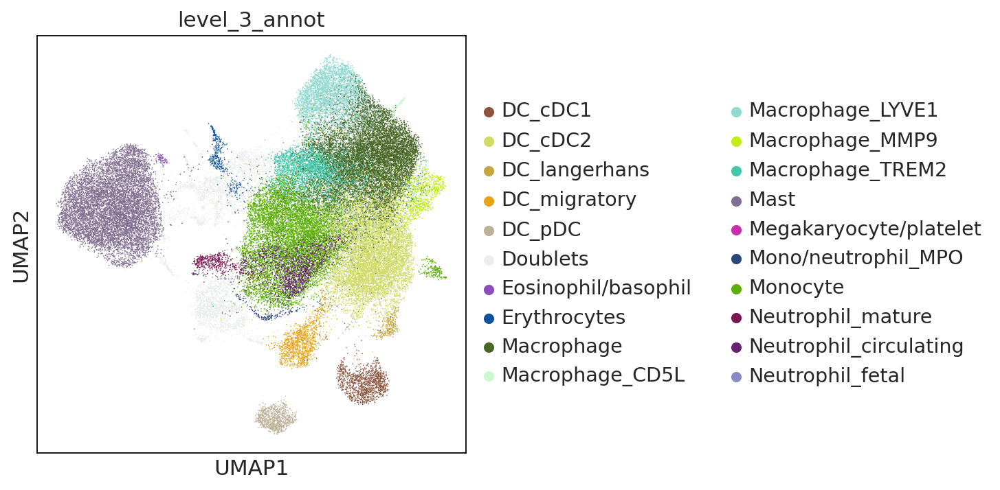

In [228]:
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(bdata,color='level_3_annot',palette = ['#8c543f',#DC_cDC1
'#cfdb65',#DC_cDC2
'#c7a642',#DC_langerhans
'#e6a519',#DC_migratory
'#bdb197',#DC_pDC
 '#ebeded',#doublets
'#8b4eba',#Eosinophil/basophil
'#0e539c',#Erythrocytes
'#486626',#Macrophage
'#caf9cf',#Macrophage_CD5L
'#8fd9d0',#Macrophage_LYVE1
'#c1ed15',#Macrophage_MMP9
'#42c7ac',#Macrophage_TREM2
'#826e91',#Mast
'#c730aa',#Megakaryocyte/platelet
'#2a497a',#Mono/neutrophil_MPO
'#5baf07',#Monocyte 
    
    '#7a1853',#neutrophil_mature
                                                   '#682370',#neutrophil_circulating
   
    '#8b89c6', #neutrophil_fetal
                                                  
#'#000000'#unknown
                                                                       ],save='myeloid_pooled.healthy.disease.pdf')

In [232]:
bdata.obs.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/metadata/combined_healthy_disease/Myeloid_pooled_healthy_disease_neutrophils_xscanvi.20231207.csv')

In [233]:
del bdata.obs

In [234]:
bdata.write_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/combined_healthy_disease/Myeloid_pooled_healthy_disease_neutrophils_xscanvi.20231207.h5ad')

In [20]:
#plot neutrophil score

In [21]:
bdata = sc.read_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/combined_healthy_disease/Myeloid_pooled_healthy_disease_neutrophils_xscanvi.20231207.h5ad')

In [22]:
bdata.obs = pd.read_csv('/nfs/team205/ao15/Megagut/Annotations_v3/metadata/combined_healthy_disease/Myeloid_pooled_healthy_disease_neutrophils_xscanvi.20231207.csv',index_col=0)

/home/jovyan/my-conda-envs/standard_plotting/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3437: DtypeWarning: Columns (84,100,101,102,103,106,107,109,110,112,113,114,115,116,117,118,120,122,123,125,127,128) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


In [23]:
neut_markers = [
        "LTF",
        "CD24",
        "S100A8",
        "S100A9",
        "S100A12",
        "PROK2",
        "CR1",
        "MMP9",
        "FCGR3B",
    "CXCR2"
    ]

In [24]:
sc.tl.score_genes(bdata, neut_markers, score_name="neut_signature")

In [26]:
mono_neutro = bdata[bdata.obs.level_3_annot.isin(['Neutrophil_circulating',
 'Neutrophil_mature',
 'Neutrophil_fetal','Mono/neutrophil_MPO','Monocyte'])].copy()

In [27]:
sc.tl.score_genes(mono_neutro, neut_markers, score_name="neut_signature")

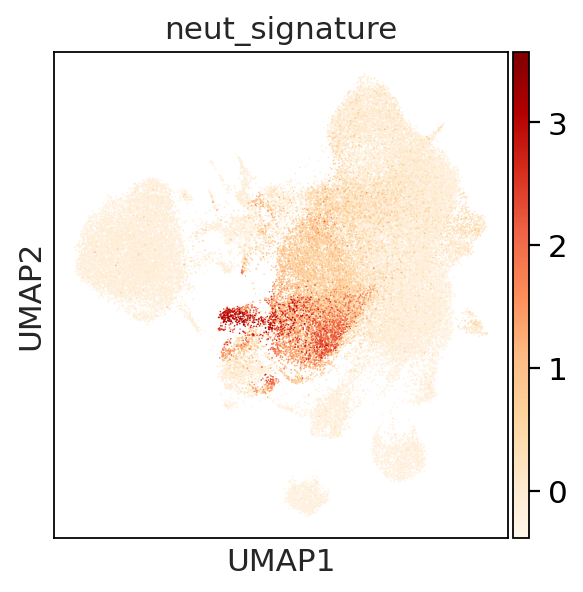

In [33]:
sc.pl.umap(bdata,color='neut_signature',cmap='OrRd',save='neut_signature_myeloid.pdf')

In [30]:
sc.pp.neighbors(mono_neutro, use_rep="X_scANVI")
sc.tl.umap(mono_neutro)

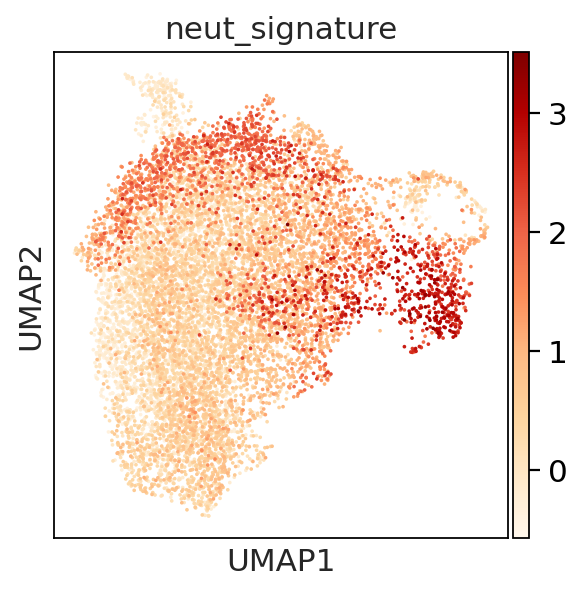

In [32]:
sc.pl.umap(mono_neutro,color='neut_signature',cmap='OrRd',save='neut_signature_mono_neutro_subclustered.pdf')

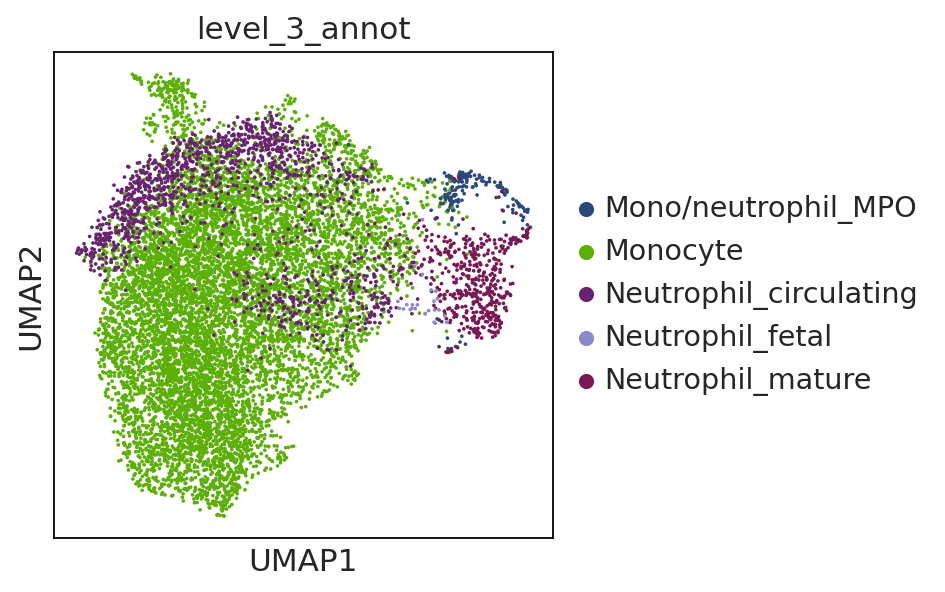

In [39]:
sc.pl.umap(mono_neutro,color='level_3_annot',
           
           palette = [
'#2a497a',#Mono/neutrophil_MPO
'#5baf07',#Monocyte 
    
   
                                                   '#682370',#neutrophil_circulating
   
    '#8b89c6', #neutrophil_fetal
                       '#7a1853',#neutrophil_mature
                     ]                                
           ,save='mono_neutro_subclustered.pdf')

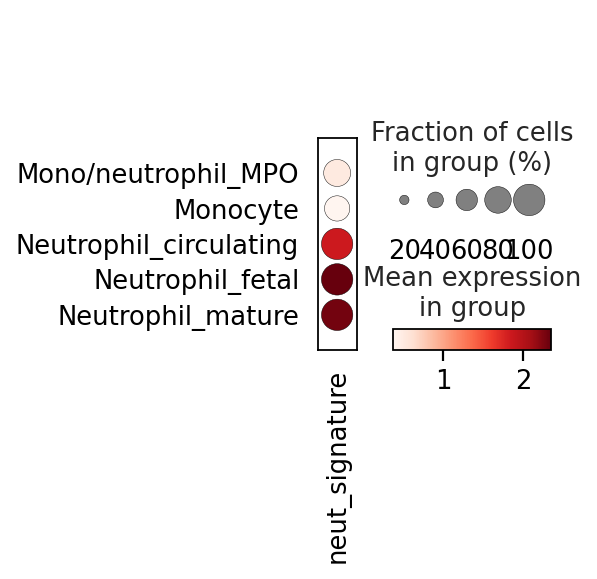

In [36]:
sc.pl.dotplot(mono_neutro,var_names='neut_signature',groupby='level_3_annot',save='dotplot_neut_signature.pdf')

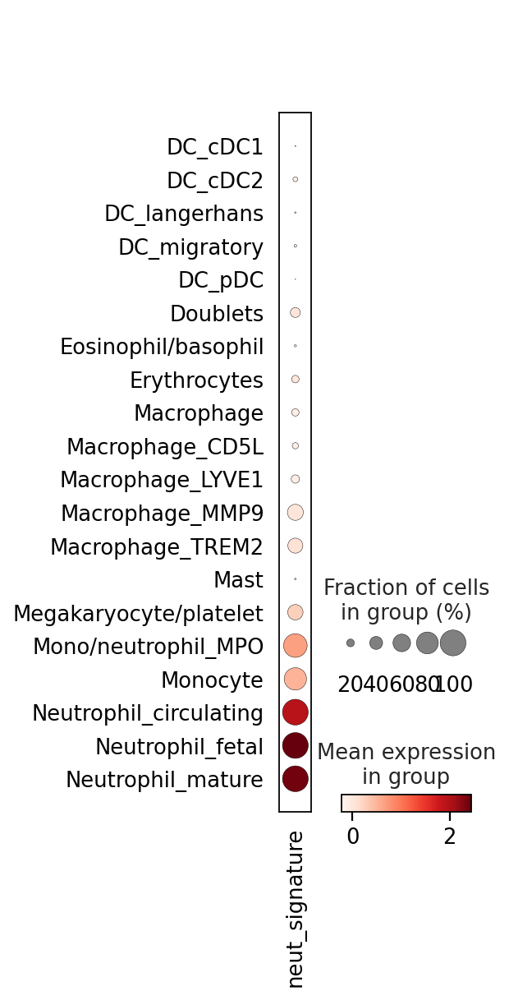

In [37]:
sc.pl.dotplot(bdata,var_names='neut_signature',groupby='level_3_annot',save='dotplot_neut_signature_all.pdf')